## Directory

[1- Import Libraries](#import-libraries)

[2-Business understanding](#business-understanding)

[3-EDA](#EDA)

[4-PREPROCESSING FOR Modeling](#preprocessing-for-modeling)

[5-Random Forest After Preprocessing](#random-forest-after-preprocessing)

[6-XGBOOST](#xgboost)


# 1- Import libraries 

In [1]:
# !pip install xgboost

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import plotly.express as px 
import seaborn as sns
import warnings 
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler
import missingno as msno
from sklearn.metrics import classification_report,confusion_matrix,precision_score,recall_score
from sklearn.utils import resample
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from imblearn.combine import SMOTETomek
from imblearn.over_sampling import SMOTE
from sklearn.metrics import f1_score
from sklearn.preprocessing import RobustScaler
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV

## 2- Business understanding 

In [3]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [2]:
business_understanding=pd.read_csv('../../Data/columns_description.csv')
business_understanding.head()

,Unnamed: 0,Table,Row,Description,Special
0,1,application_data,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_data,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_data,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_data,CODE_GENDER,Gender of the client,NaN
4,7,application_data,FLAG_OWN_CAR,Flag if the client owns a car,NaN


In [5]:
## knowing all feature meaning
Description_row=business_understanding.loc[:,'Table':'Description']
Description_row.sample(5)

,Table,Row,Description
47,application_data,YEARS_BUILD_AVG,Normalized information about building where th...
69,application_data,LIVINGAREA_MODE,Normalized information about building where th...
157,previous_application.csv,DAYS_LAST_DUE,Relative to application date of current applic...
112,application_data,FLAG_DOCUMENT_18,Did client provide document 18
127,previous_application.csv,AMT_CREDIT,Final credit amount on the previous applicatio...


## **Problem Formulation** 🔍

## **1. Define the Main Objective** 🎯

**Example:**

- **Main Objective: Improve loan approval rates and reduce default rates by analyzing the performance of vendors and different industries.** 🔍💡

---

## **2. Precisely Define the Problem** 🛠️

**Example:**

- **Determine whether there is a relationship between the performance of vendors and the industries they belong to and the approval and default rates of loans.**
- **Identify the vendors and industries associated with the highest approval rates and the lowest default rates.** 📈🔗

---

## EDA 

(Data cleansing and preparation, Insightful visuals)

In [3]:
df=pd.read_csv('../../Data/application_data.csv')
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
shape_data=df.shape
print(f'data consists of {shape_data[0]} row and {shape_data[1]} column')

data consists of 307511 row and 122 column


In [8]:
df_originaL=df.copy()

## 3-1 Data Cleaning 

In [9]:
df_null_percentage = round(df.isnull().sum()*100/len(df),2)
df_null_percentage=df_null_percentage.to_frame().rename(columns={0:'percentage'}).sort_values(by='percentage', ascending=False)
# df_null_percentage=df_null_percentage
df_null_percentage

,percentage
COMMONAREA_MEDI,69.87
COMMONAREA_AVG,69.87
COMMONAREA_MODE,69.87
NONLIVINGAPARTMENTS_MODE,69.43
NONLIVINGAPARTMENTS_AVG,69.43
NONLIVINGAPARTMENTS_MEDI,69.43
FONDKAPREMONT_MODE,68.39
LIVINGAPARTMENTS_MODE,68.35
LIVINGAPARTMENTS_AVG,68.35
LIVINGAPARTMENTS_MEDI,68.35


In [10]:
## subset columns which contains nulls and sorting it in descending order
df_null=df_null_percentage[df_null_percentage['percentage']>0]
df_null=df_null.sort_values(by='percentage',ascending=False)
df_null

,percentage
COMMONAREA_MEDI,69.87
COMMONAREA_AVG,69.87
COMMONAREA_MODE,69.87
NONLIVINGAPARTMENTS_MODE,69.43
NONLIVINGAPARTMENTS_AVG,69.43
NONLIVINGAPARTMENTS_MEDI,69.43
FONDKAPREMONT_MODE,68.39
LIVINGAPARTMENTS_MODE,68.35
LIVINGAPARTMENTS_AVG,68.35
LIVINGAPARTMENTS_MEDI,68.35


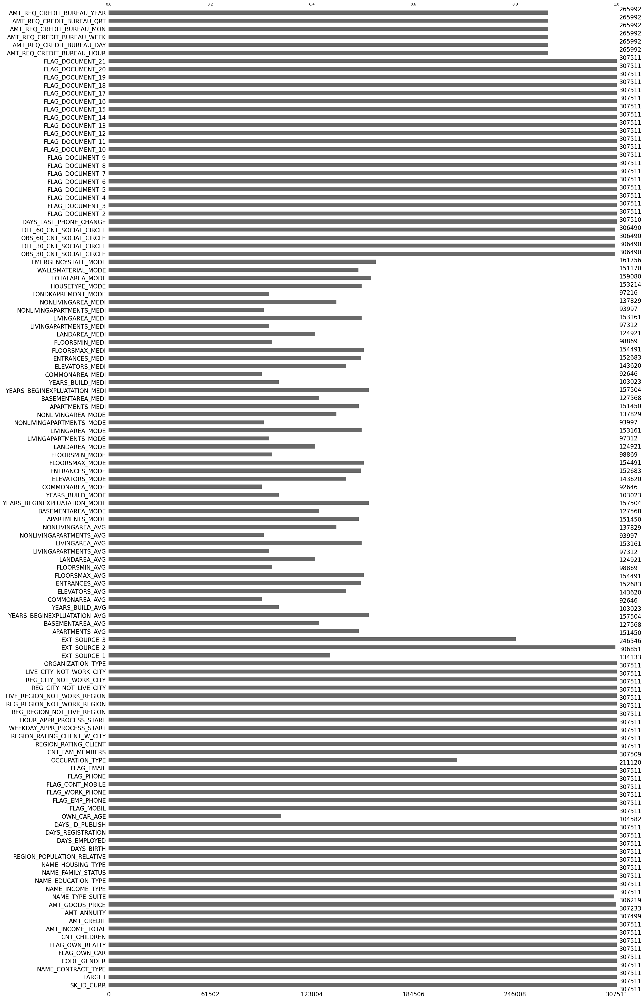

In [11]:
## null_bar
null_bar=msno.bar(df)

In [12]:
## number of columns contains nulls
df_null.shape[0]

64

 ## Handling Columns with High Percentage of Nulls 📊

I observe that many columns with null values have a high percentage of missing data, ranging from **50% to about 70%**. Given this, the following actions are advisable:

1. **Drop Columns with High Percentage of Nulls** 🚮
   - **Drop columns** where the percentage of null values is greater than **50%**. These columns are often less useful due to their high proportion of missing data.

2. **Fill Remaining Columns with Mean** 🧮
   - For other columns with missing values below this threshold, **fill missing values** with the mean of each column. This approach helps in retaining useful data while addressing missing values effectively.

## Calculating Correlation for Columns with More Than 50% Missing Values 🔍

To analyze the correlation of columns that have more than **50%** missing values, follow these steps:

### 1. Identify Columns with More Than 50% Missing Values 🚨

First, determine which columns have a high percentage of missing values:

In [13]:
columns_to_drop=df_null[df_null['percentage']>50]
columns_to_drop=list(columns_to_drop.index)
len(columns_to_drop)

41

<Axes: >

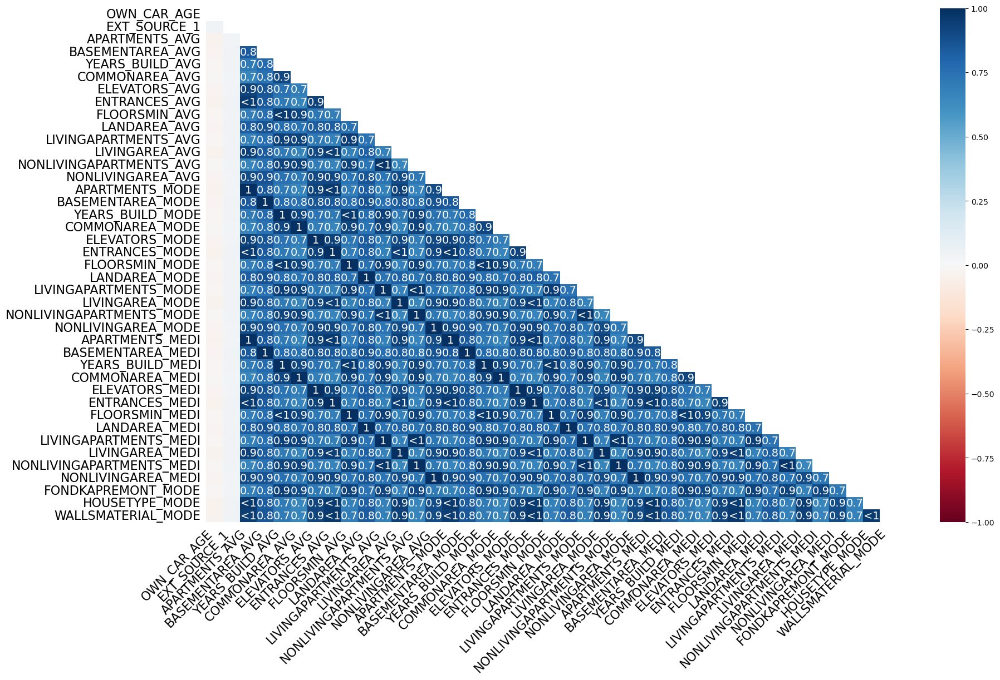

In [14]:
## check corr of columns 
columns_to_keep = [col for col in df.columns if col  in columns_to_drop]

df1 = df[columns_to_keep]

msno.heatmap(df1)

In [15]:
df1.shape

(307511, 41)

In [16]:
df.isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

The features listed have **very powerful relationships** with missing values in our dataset:


**Drop** rows with nulls in those columns insted of drop columns as it may have strong relation 


In [17]:
df.shape

(307511, 122)

In [18]:
# columns_to_keep = [col for col in df.columns if col not in columns_to_drop]

# df = df[columns_to_keep]

# Drop rows with less than 3 non-null values

df_no_nulls = df[df['AMT_REQ_CREDIT_BUREAU_DAY'].notnull()]

print(df_no_nulls.shape)

(265992, 122)


In [19]:
df.shape

(307511, 122)

In [20]:
## checking for duplicates
df_no_nulls.duplicated(subset=['TARGET'	,'NAME_CONTRACT_TYPE',	'CODE_GENDER',	'FLAG_OWN_CAR',	'FLAG_OWN_REALTY'	,'CNT_CHILDREN',	'AMT_INCOME_TOTAL'	,'AMT_CREDIT',	'AMT_ANNUITY',
                                # 'AMT_GOODS_PRICE',	'NAME_TYPE_SUITE',	'NAME_INCOME_TYPE',	'NAME_EDUCATION_TYPE',	'NAME_FAMILY_STATUS'
                                ]).sum().sum()


52128

## Dropping Duplicated Rows 🚮

We could **drop duplicated rows** based on the following features because it is not logical to have customers with identical values across these attributes:

- **<span style="color: #ff6347;">`TARGET`</span>**
- **<span style="color: #4682b4;">`NAME_CONTRACT_TYPE`</span>**
- **<span style="color: #32cd32;">`CODE_GENDER`</span>**
- **<span style="color: #ff1493;">`FLAG_OWN_CAR`</span>**
- **<span style="color: #1e90ff;">`FLAG_OWN_REALTY`</span>**
- **<span style="color: #ff4500;">`CNT_CHILDREN`</span>**
- **<span style="color: #8a2be2;">`AMT_INCOME_TOTAL`</span>**
- **<span style="color: #20b2aa;">`AMT_CREDIT`</span>**
- **<span style="color: #ff8c00;">`AMT_ANNUITY`</span>**

Having duplicate entries with all these features being exactly the same is unrealistic and might indicate data quality issues. Removing such duplicates ensures that our dataset is more representative and avoids redundancy.

In [21]:
df_no_nulls_no_duplic = df_no_nulls.drop_duplicates(subset=['TARGET','NAME_CONTRACT_TYPE','CODE_GENDER','FLAG_OWN_CAR','FLAG_OWN_REALTY','CNT_CHILDREN','AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY'])
df_no_nulls.shape[0],df_no_nulls_no_duplic.shape[0]

(265992, 213864)

the output `(df_no_nulls.shape[0], df_no_nulls_no_duplic.shape[0])` gives a tuple containing the number of rows in the original DataFrame and the number of rows after duplicates have been removed. This helps in determining how many duplicate rows were removed from the DataFrame.

In [22]:
df_no_nulls_no_duplic.shape

(213864, 122)

In [23]:
columns_to_drop_=df_null[df_null['percentage']<=50]
columns_to_drop_=list(columns_to_drop_.index)
len(columns_to_drop_)

23

<Axes: >

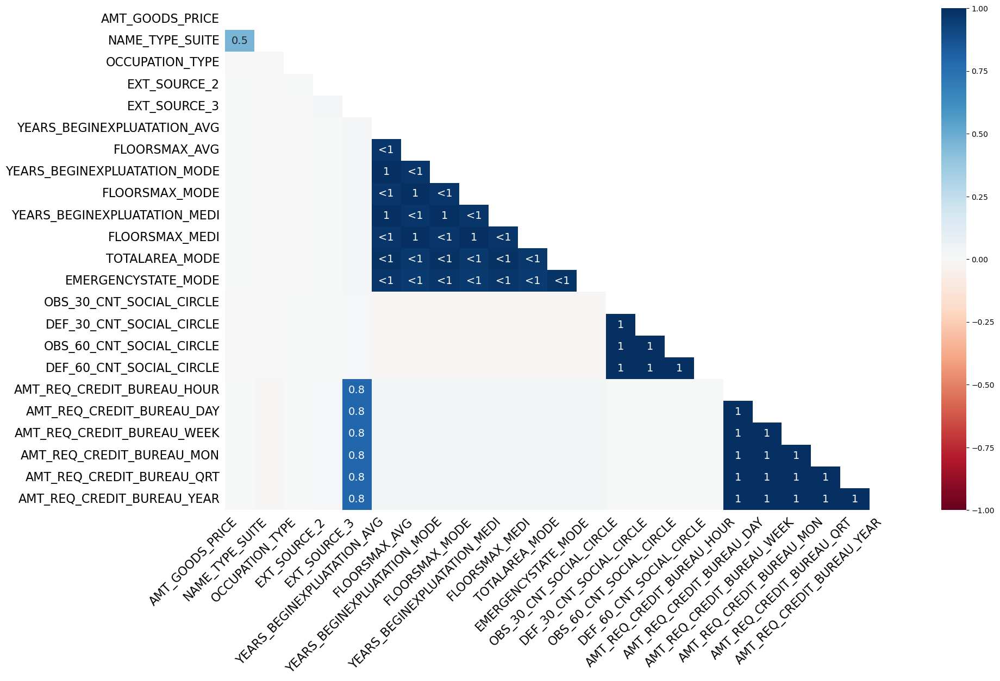

In [24]:

columns_to_keep_ = [col for col in df.columns if col  in columns_to_drop_]

df2 = df[columns_to_keep_]

msno.heatmap(df2)

In [25]:
columns_to_keep_

['AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'OCCUPATION_TYPE',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'EMERGENCYSTATE_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

In [26]:
df_for_corr=df[['AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'OCCUPATION_TYPE',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'FLOORSMAX_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'FLOORSMAX_MEDI',
 'TOTALAREA_MODE',
 'EMERGENCYSTATE_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR','TARGET']]
df_for_corr.head()

,AMT_GOODS_PRICE,NAME_TYPE_SUITE,OCCUPATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,TARGET
0,351000.0,Unaccompanied,Laborers,0.262949,0.139376,0.9722,0.0833,0.9722,0.0833,0.9722,0.0833,0.0149,No,2.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,1
1,1129500.0,Family,Core staff,0.622246,NaN,0.9851,0.2917,0.9851,0.2917,0.9851,0.2917,0.0714,No,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,135000.0,Unaccompanied,Laborers,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,297000.0,Unaccompanied,Laborers,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0
4,513000.0,Unaccompanied,Core staff,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [27]:
## corr of this columns with Target)
corr=df_for_corr.corr()
corr_target=corr.loc['TARGET']
corr_target

AMT_GOODS_PRICE                -0.039645
EXT_SOURCE_2                   -0.160472
EXT_SOURCE_3                   -0.178919
YEARS_BEGINEXPLUATATION_AVG    -0.009728
FLOORSMAX_AVG                  -0.044003
YEARS_BEGINEXPLUATATION_MODE   -0.009036
FLOORSMAX_MODE                 -0.043226
YEARS_BEGINEXPLUATATION_MEDI   -0.009993
FLOORSMAX_MEDI                 -0.043768
TOTALAREA_MODE                 -0.032596
OBS_30_CNT_SOCIAL_CIRCLE        0.009131
DEF_30_CNT_SOCIAL_CIRCLE        0.032248
OBS_60_CNT_SOCIAL_CIRCLE        0.009022
DEF_60_CNT_SOCIAL_CIRCLE        0.031276
AMT_REQ_CREDIT_BUREAU_HOUR      0.000930
AMT_REQ_CREDIT_BUREAU_DAY       0.002704
AMT_REQ_CREDIT_BUREAU_WEEK      0.000788
AMT_REQ_CREDIT_BUREAU_MON      -0.012462
AMT_REQ_CREDIT_BUREAU_QRT      -0.002022
AMT_REQ_CREDIT_BUREAU_YEAR      0.019930
TARGET                          1.000000
Name: TARGET, dtype: float64

## Columns with Very Low Correlation to Target 📉

**i will drop this columns before modeling but i want to use the important of this columns in analysis**


---------------------------------
### Potentially Useful Columns: 🚀

- **<span style="color: #1f77b4;">`AMT_GOODS_PRICE`</span>**: Represents the price of the goods requested. This can be useful if it is related to the likelihood of defaulting or assessing creditworthiness.

- **<span style="color: #ff7f0e;">`EXT_SOURCE_2`, `EXT_SOURCE_3`</span>**: External sources, possibly credit scores or evaluations from credit bureaus. These can be useful for determining the individual’s ability to repay.

- **<span style="color: #2ca02c;">`YEARS_BEGINEXPLUATATION_AVG`, `FLOORSMAX_AVG`</span>**: Provide average values for the age of exploitation and maximum floor levels, which could be relevant if they relate to creditworthiness or property value.

- **<span style="color: #d62728;">`AMT_REQ_CREDIT_BUREAU_HOUR`, `AMT_REQ_CREDIT_BUREAU_DAY`, `AMT_REQ_CREDIT_BUREAU_WEEK`, `AMT_REQ_CREDIT_BUREAU_MON`, `AMT_REQ_CREDIT_BUREAU_QRT`, `AMT_REQ_CREDIT_BUREAU_YEAR`</span>**: Indicate the number of credit inquiries over various time periods. These can be useful for understanding the individual’s credit activity.

- **<span style="color: #9467bd;">`OBS_30_CNT_SOCIAL_CIRCLE`, `DEF_30_CNT_SOCIAL_CIRCLE`, `OBS_60_CNT_SOCIAL_CIRCLE`, `DEF_60_CNT_SOCIAL_CIRCLE`</span>**: Number of observations and defaults within the social circle over 30 or 60 days. They might help in understanding social influences on creditworthiness.

### Potentially Less Directly Useful Columns:

- **<span style="color: #8c564b;">`NAME_TYPE_SUITE`</span>**: Type of suite or living arrangement may not be directly useful for credit assessment unless it has an indirect impact.

- **<span style="color: #e377c2;">`OCCUPATION_TYPE`</span>**: The type of occupation could be useful, but its impact depends on how strongly it correlates with creditworthiness.

- **<span style="color: #7f7f7f;">`YEARS_BEGINEXPLUATATION_MODE`, `FLOORSMAX_MODE`, `YEARS_BEGINEXPLUATATION_MEDI`, `FLOORSMAX_MEDI`, `TOTALAREA_MODE`, `EMERGENCYSTATE_MODE`</span>**: Statistical features (mode, median) may be useful but require further analysis to determine their importance.

In [28]:
df_no_nulls_no_duplic.shape

(213864, 122)

In [29]:
## drop_Less Directly Useful Columns
df_no_nulls_no_duplic.drop(columns=['NAME_TYPE_SUITE','OCCUPATION_TYPE','YEARS_BEGINEXPLUATATION_MODE','FLOORSMAX_MODE','YEARS_BEGINEXPLUATATION_MEDI','FLOORSMAX_MEDI','TOTALAREA_MODE','EMERGENCYSTATE_MODE'],inplace=True)

In [30]:
df_no_nulls_no_duplic.shape

(213864, 114)

In [31]:
df_no_nulls_no_duplic.isnull().sum()

SK_ID_CURR                          0
TARGET                              0
NAME_CONTRACT_TYPE                  0
CODE_GENDER                         0
FLAG_OWN_CAR                        0
FLAG_OWN_REALTY                     0
CNT_CHILDREN                        0
AMT_INCOME_TOTAL                    0
AMT_CREDIT                          0
AMT_ANNUITY                        11
AMT_GOODS_PRICE                    64
NAME_INCOME_TYPE                    0
NAME_EDUCATION_TYPE                 0
NAME_FAMILY_STATUS                  0
NAME_HOUSING_TYPE                   0
REGION_POPULATION_RELATIVE          0
DAYS_BIRTH                          0
DAYS_EMPLOYED                       0
DAYS_REGISTRATION                   0
DAYS_ID_PUBLISH                     0
OWN_CAR_AGE                    135039
FLAG_MOBIL                          0
FLAG_EMP_PHONE                      0
FLAG_WORK_PHONE                     0
FLAG_CONT_MOBILE                    0
FLAG_PHONE                          0
FLAG_EMAIL  

## 3-2 EDA Analysis

In [32]:
df_no_nulls_no_duplic.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.6341,0.0144,0.0000,0.0690,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.6243,0.0144,0.00,0.0690,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,"Stone, brick",2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.8040,0.0497,0.0806,0.0345,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.7987,0.0608,0.08,0.0345,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,Block,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-431

## Determining the percentage of Clients Who Defaulted on the Loan 📊


In [33]:
df = df_no_nulls_no_duplic.copy()

In [34]:
round(df['TARGET'].value_counts(normalize=True)*100)

0    91.0
1     9.0
Name: TARGET, dtype: float64

 In our **dataset**

- **<span style="color: #ff6347;">91%</span>** of the clients are in default.
- **<span style="color: #4682b4;">9%</span>** of the clients have not defaulted.

## Visualization by Funnel Chart to Clarify Percentage 📉

A funnel chart is an effective way to visualize the percentage of clients who defaulted on their loans. It helps to clearly represent the stages and proportions of clients at each stage.


In [35]:
TARGET=df['TARGET'].value_counts()
TARGET=TARGET.to_frame()
TARGET=TARGET.reset_index()
TARGET=TARGET.rename(columns={'index':'statue'})
TARGET=TARGET.set_index('statue')
TARGET

,TARGET
statue,
0,194578
1,19286


In [36]:
fig=px.funnel(TARGET,color_discrete_sequence=['red'])
fig.update_layout(title='showing the count of status in paying loans'
)

- **As we see 19,286 k don't pay the loans**

- **194578 pay the loans**
------------------------------------

# Visuals - **Business Questions** 📊

## What are the Reasons for Defaulting on the Loan? 🤔

**Distribution of Target Variable**
------------------------------------------
**What is the proportion of clients who defaulted on their loans versus those who did not?**  
**[Answered]**

## Demographic Factors:
-------------------------------------
**How does age influence loan default rates?**  
Explore if there is a correlation between age and the likelihood of defaulting on a loan.

**Are there differences in default rates based on gender?**  
Analyze whether gender impacts the probability of loan default.

**How does marital status affect the likelihood of default?**  
Examine if marital status is associated with higher or lower default rates.

## Employment and Income:
------------------------------------------------
**How does income level correlate with the likelihood of default?**  
Assess if higher or lower income levels are linked to a higher probability of default.


## Loan Characteristics:
-------------------------------------
**What types of loans have higher default rates?**  
Identify which types of loans (e.g., cash, resolving) are associated with higher default rates.

**How do interest rates correlate with default rates?**  
Determine if higher or lower interest rates affect the probability of default.

**Is there a relationship between loan amount and the likelihood of default?**  
Analyze if the amount of the loan influences default rates.


## External Economic Factors:
-------------------------------------
**How do macroeconomic factors like unemployment rate and inflation correlate with loan default rates?**  
Assess the relationship between broader economic factors and default rates.

## Additional Factors:
-------------------------------------

**What is the role of education level in loan defaults?**  
Examine how education levels correlate with loan default rates.

**Are there any patterns or correlations with family size or number of dependents?**  
Explore if family size or number of dependents influences the probability of default.

<h1 style="color: #2E86C1;">How Does Age Influence Loan Default Rates?</h1>

<p style="color: #5D6D7E;">Understanding the impact of age on loan default rates can provide valuable insights for financial institutions and help tailor risk management strategies. This analysis explores the relationship between age and the likelihood of defaulting on loans, shedding light on potential trends and patterns.</p>

# EXTRACT Age 🔧

<p style="color: #5D6D7E;">Extract age involves creating new feature  from Days Birth </p>

<h1 style="color: color: #5D6D7E;;">Age ⏳</h1>

In [37]:
## number of days since the client is born
df['DAYS_BIRTH'].head()


0    -9461
1   -16765
2   -19046
4   -19932
5   -16941
Name: DAYS_BIRTH, dtype: int64

In [38]:
## we can calculate age
df['age_year']=df['DAYS_BIRTH']/-365
## to extract the exact number
df['age_year']=df['age_year'].astype('int')
df['age_year'].head()

0    25
1    45
2    52
4    54
5    46
Name: age_year, dtype: int32

In [39]:
## knowing age range
min_age=df['age_year'].min()
max_age=df['age_year'].max()
print(f'age range from {min_age} to {max_age} ')

age range from 20 to 69 


<Axes: xlabel='age_year', ylabel='Density'>

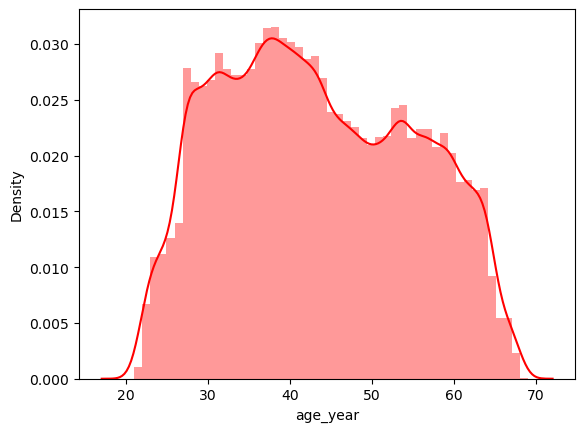

In [40]:
## i want to see the disturbution of ages 
sns.distplot(df['age_year'],color='red')

## Key Insight: Age Distribution of Defaulted Clients 📊

In [41]:
## showing the majority of age year who defaulted loans
defaulted_clients_age=df[df['TARGET']==1]['age_year']
defaulted_clients_age=defaulted_clients_age.to_frame()
fig=px.box(defaulted_clients_age['age_year'],color_discrete_sequence=['red'])
fig.update_layout(xaxis_title='AGE_YEAR',
                  yaxis_title='TARGET',
                  title='Age Distribution of Defaulted Clients'
)

**<span style="color: red;">The majority of clients who defaulted on their loans are between the ages of <strong>31 to 48</strong>.</span>**  
This finding highlights a significant age range that is most impacted by loan defaults.



 ## Categorizing Age Groups AND BINNING 👶👴

In [42]:
## divide age into categories 
age_bins = [20, 29, 39, 49, 59, 69]
age_labels = ['20-29', '30-39', '40-49', '50-59', '60-69']
df['AGE_CATEGORY'] = pd.cut(df['age_year'], bins=age_bins, labels=age_labels, right=False)
df['AGE_CATEGORY'].head()

0    20-29
1    40-49
2    50-59
4    50-59
5    40-49
Name: AGE_CATEGORY, dtype: category
Categories (5, object): ['20-29' < '30-39' < '40-49' < '50-59' < '60-69']

In [43]:
## count of Age category which apply to loan 
count_AGE_category_on_data=df['AGE_CATEGORY'].value_counts()
count_AGE_category_on_data=count_AGE_category_on_data.to_frame()
count_AGE_category_on_data=count_AGE_category_on_data.reset_index()
count_AGE_category_on_data=count_AGE_category_on_data.rename(columns={'index':'AGE_CATEGORY','AGE_CATEGORY':'count'})
count_AGE_category_on_data

,AGE_CATEGORY,count
0,30-39,59780
1,40-49,56243
2,50-59,46492
3,60-69,28101
4,20-29,23239


## Key Insight: Age Category of Loan Applicants 🏦💡

**<span style="color: #1E90FF;">AGE_CATEGORY 30-39</span> is the most common category of people who apply for loans.**  
This indicates that individuals in this age range are the most active when it comes to loan applications.


In [44]:
## age category count of applying for loans
px.pie(
    count_AGE_category_on_data,names='AGE_CATEGORY',
    values='count',
    color_discrete_sequence=['green','blue','orange','red','yellow'],
  
)

**Most people who default on their loans are between the ages of **31 and 48**.**  
However, it's important to consider the percentage of total defaulters in this age range, as this helps us understand the significance relative to the total number of defaulters.


In [45]:
## Age category _ which _defaulted_on_loans
defaulted_on_loans=df[df['TARGET']==1]
age_category_Who_defaulted_on_loans=defaulted_on_loans.groupby('AGE_CATEGORY')['TARGET'].agg('count')
age_category_Who_defaulted_on_loans=age_category_Who_defaulted_on_loans.to_frame()
age_category_Who_defaulted_on_loans=age_category_Who_defaulted_on_loans.sort_values(by='TARGET',ascending=False)
age_category_Who_defaulted_on_loans=age_category_Who_defaulted_on_loans.reset_index()
age_category_Who_defaulted_on_loans

,AGE_CATEGORY,TARGET
0,30-39,6373
1,40-49,4902
2,50-59,3364
3,20-29,2959
4,60-69,1688


In [46]:
## the most percentage category which defaulted_on_loans 
data_Category_percentage=count_AGE_category_on_data.merge(age_category_Who_defaulted_on_loans,on='AGE_CATEGORY')
data_Category_percentage=data_Category_percentage.rename(columns={'count':'All_Count','TARGET':'count_defaulted_on_loans'})
data_Category_percentage

,AGE_CATEGORY,All_Count,count_defaulted_on_loans
0,30-39,59780,6373
1,40-49,56243,4902
2,50-59,46492,3364
3,60-69,28101,1688
4,20-29,23239,2959


In [47]:
## extract percentage
data_Category_percentage['percentage_on_defaulted_on_loans']=data_Category_percentage['count_defaulted_on_loans']/data_Category_percentage['All_Count']
data_Category_percentage=data_Category_percentage.sort_values(by='percentage_on_defaulted_on_loans',ascending=False)
data_Category_percentage

,AGE_CATEGORY,All_Count,count_defaulted_on_loans,percentage_on_defaulted_on_loans
4,20-29,23239,2959,0.127329
0,30-39,59780,6373,0.106608
1,40-49,56243,4902,0.087158
2,50-59,46492,3364,0.072357
3,60-69,28101,1688,0.060069


## Key Insights: Loan Default Age Distribution 📊🔍

- **<span style="red">Top Percentage in Age Category Defaulting on Loans:</span>** **20-29**  
  The highest percentage of loan defaults is observed in the age group **`20-29 years old`**. Despite a smaller number of total applicants, the default rate in this age group is notably high. 🚀

- **<span style="red">Age Category with Fewer Loan Applicants:</span>**  
  This age group has fewer applicants but still shows significant default rates relative to its size. 📉

- **<span style="red">Lowest Percentage in Age Category:</span>** **60-69**  
  The age group **`60-69 years old`** exhibits the lowest percentage of loan defaults. This age range has both a lower count of defaults and a smaller proportion relative to the total number of defaults. 🕰️


In [48]:
fig = px.line(
    data_Category_percentage,
    x='AGE_CATEGORY',
    y='percentage_on_defaulted_on_loans',
    color_discrete_sequence=['#FF6347'],  # Color for the line
    markers=True  # Add markers to the line for better visibility
)

# Update layout for better presentation
fig.update_layout(
    title='Percentage of Loan Defaults by Age Category',
    title_font_size=16,
    title_font_color='#333333',
    xaxis_title='Age Category',
    yaxis_title='Percentage of Defaulted Loans (%)',
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    xaxis_title_font_color='#555555',
    yaxis_title_font_color='#555555',
    xaxis_tickangle=-45,  # Rotate x-axis labels for readability
    plot_bgcolor='#f2f2f2',  # Light background color
    paper_bgcolor='#ffffff',  # White background for the whole chart
    showlegend=False  # Hide legend if not necessary
)

## Gender Distribution of Loan 👩‍💼👨‍💼

Understanding how loan defaults are distributed across different genders can provide valuable insights into demographic risk factors.

### Key Insight

**<span style="red;">**`Gender Distribution`**:</span>**  
Analyze the proportion of loan defaults between different genders to identify if there is a significant disparity or trend.


In [49]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,age_year,AGE_CATEGORY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.6341,0.0144,0.0000,0.0690,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.6243,0.0144,0.00,0.0690,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,"Stone, brick",2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,25,20-29
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.8040,0.0497,0.0806,0.0345,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.7987,0.0608,0.08,0.0345,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,Block,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,45,40-49
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,52,50-59
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Working,Secondary / secondary special,Single / not mar

In [50]:
## Gender_count
Gender_count=df['CODE_GENDER'].value_counts()
Gender_count=Gender_count.to_frame()
Gender_count=Gender_count.reset_index()
Gender_count=Gender_count.rename(columns={'index':'Gender','CODE_GENDER':'count'})
Gender_count

,Gender,count
0,F,137304
1,M,76556
2,XNA,4


In [51]:
fig=px.histogram(Gender_count,x='Gender',y='count',color_discrete_sequence=['red'])
fig.update_layout(title='Gender count (All)',
                  xaxis_title='gender',
                  yaxis_title='count'
)

## Gender Distribution Conclusion 📊

**<span style="black;">**`We can conclude that`**:</span>**

- **Females** are the most common gender applying for loans. 👩‍💼
- **Males** follow in the number of loan applications. 👨‍💼
- **XNA** (which represents individuals who did not specify their gender) has the least number of applications. ❓

### Explanation:

- **XNA**: This category includes individuals who chose not to specify their gender or for whom gender information is missing.
--------------------------


## Count of Loan Defaults by Gender 👩‍💼👨‍💼❓

Understanding the count of loan defaults across different genders helps in analyzing patterns and trends in loan defaults.


In [52]:
## knowing the count of female and male and xna who defaulated on loans 
gender_defaulted_on_loans=defaulted_on_loans.groupby('CODE_GENDER')['TARGET'].agg('count')
gender_defaulted_on_loans=gender_defaulted_on_loans.to_frame()
gender_defaulted_on_loans=gender_defaulted_on_loans.reset_index()
gender_defaulted_on_loans=gender_defaulted_on_loans.rename(columns={'CODE_GENDER':'Gender','TARGET':'count gender_defaulted_on_loans'})
gender_defaulted_on_loans

,Gender,count gender_defaulted_on_loans
0,F,11101
1,M,8185


## Gender Distribution of Loan Defaults 👩‍💼👨‍💼

### Key Insights

- **The number of males and females who defaulted on loans** has been detailed in the previous sections. 📊
  
- **XNA (Unknown Gender)**: All clients categorized as XNA have paid their loans and have not defaulted. Therefore, the XNA category does not appear in the list of defaults. ❌

In [53]:
## bar plot to explain the count
fig = px.bar(
    gender_defaulted_on_loans,
    x='Gender',
    y='count gender_defaulted_on_loans',
    color='count gender_defaulted_on_loans',
    color_continuous_scale=px.colors.sequential.RdBu,
    text='count gender_defaulted_on_loans',
    title='Loan Default Counts by Gender',
)

# Update layout to enhance appearance
fig.update_layout(
    title={
        'text': "Loan Default Counts by Gender",
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24}
    },
    xaxis_title='Gender',
    yaxis_title='Count of Defaulted Loans',
    xaxis=dict(
        title_font_size=16,
        tickfont_size=14,
        tickangle=0
    ),
    yaxis=dict(
        title_font_size=16,
        tickfont_size=14
    ),
    coloraxis_colorbar=dict(
        title='Count',
        tickvals=[800, 1200],
        ticktext=['Low', 'High'],
        len=0.75
    ),
    plot_bgcolor='rgba(240, 240, 240, 0.5)',  # Light background color
    paper_bgcolor='white',  # White background color for the paper
    margin=dict(l=40, r=40, t=60, b=40),  # Adjust margins
    title_font_color='darkblue',  # Dark blue color for the title
)

# Update traces for better text formatting
fig.update_traces(
    texttemplate='%{text:.0f}',  # Format text labels
    textposition='outside',  # Position text outside the bars
    marker=dict(line=dict(color='black', width=1))  # Add border to bars
)

# Show the figure
fig.show()

**We confirmed that:**

- **Females**: Females are the most common gender type among those who defaulted on loans. However, it's crucial to analyze percentages rather than just raw counts, as the total number of females (both paying and defaulting) is higher compared to males. Therefore, even though females have a higher number of defaults, the percentage might not be the highest. 📉👩‍💼

- **XNA (Unknown Gender)**: All clients classified as XNA (those who did not specify their gender) have repaid their loans and do not appear as defaulters. This category is not represented in the default figures. ❌❓

### Next Steps:

- **Percentage Analysis**: To gain a comprehensive understanding, we need to examine the default rates as a percentage of the total number of loan applications for each gender.

- **Exclusion of XNA**: Since XNA clients do not default, this group is excluded from the analysis of loan defaults.


In [54]:
gender_defaulted_on_loans

,Gender,count gender_defaulted_on_loans
0,F,11101
1,M,8185


In [55]:
## percentage on defaulted_on_loans by Gender 
percentage_on_defaulted_on_loans_by_Gender=Gender_count.merge(gender_defaulted_on_loans,left_on='Gender',
right_on='Gender')
percentage_on_defaulted_on_loans_by_Gender

,Gender,count,count gender_defaulted_on_loans
0,F,137304,11101
1,M,76556,8185


In [56]:
## specify percentage 
percentage_on_defaulted_on_loans_by_Gender['percentage']=percentage_on_defaulted_on_loans_by_Gender['count gender_defaulted_on_loans']/percentage_on_defaulted_on_loans_by_Gender['count']
percentage_on_defaulted_on_loans_by_Gender=percentage_on_defaulted_on_loans_by_Gender.sort_values(by='percentage',ascending=False)
percentage_on_defaulted_on_loans_by_Gender

,Gender,count,count gender_defaulted_on_loans,percentage
1,M,76556,8185,0.106915
0,F,137304,11101,0.080850


- **Percentage of Defaults**: The percentage of loan defaults **`is higher among males compared to females`**. Despite the higher number of female defaulters, when expressed as a percentage of the total number of loan applications, males show a greater default rate. 📈👨‍💼

- **Females**: While the total count of female defaulters is higher, the percentage of defaults relative to the total number of loan applications is less compared to males.

- **XNA (Unknown Gender)**: Clients classified as XNA (those who did not specify their gender) have repaid their loans and are not included in the default statistics. ❌❓

### Insights:

- **Percentage Analysis**: Males have a higher percentage of defaults relative to their total loan applications, even if the raw number of defaults is lower than that of females.

- **Understanding XNA**: XNA clients do not contribute to the default figures as they all have paid their loans

<Axes: xlabel='Gender', ylabel='percentage'>

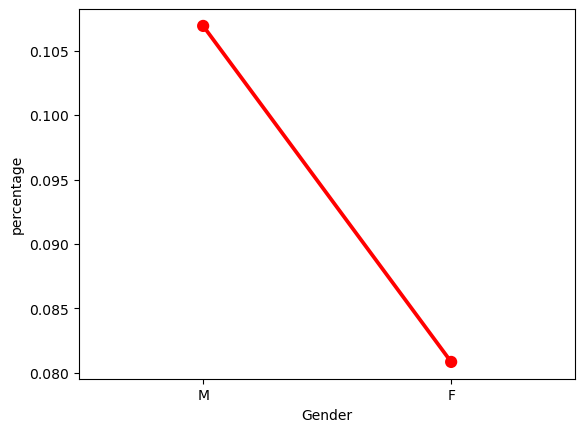

In [57]:
sns.pointplot(percentage_on_defaulted_on_loans_by_Gender,x='Gender',y='percentage',color='red')

### Education Type

In [58]:
## knowing the most Education type which apply to loans
Education_Type =df['NAME_EDUCATION_TYPE'].value_counts()
Education_Type=Education_Type.to_frame().reset_index()
Education_Type=Education_Type.rename(columns={'NAME_EDUCATION_TYPE':'Education_type'})
Education_Type

,index,Education_type
0,Secondary / secondary special,150212
1,Higher education,54007
2,Incomplete higher,6940
3,Lower secondary,2587
4,Academic degree,118


## Educational Background of Loan Applicants 🎓

**Key Insights:**

- **Secondary / Secondary Special**: Individuals with secondary or secondary special education represent the largest group applying for loans. 📚

- **Academic Degree**: Those with an academic degree are the least frequent among loan applicants. 🎓


**Why Secondary / Secondary Special Education Applicants Are Most Common:**

1. **Economic Factors**: Individuals with secondary or secondary special education might be more likely to need financial assistance due to economic constraints. They may be seeking loans to support their daily expenses, education, or small businesses.

2. **Employment Type**: Jobs requiring secondary education may have lower wages, increasing the need for financial support through loans.

3. **Access to Financial Products**: Loan products might be more accessible or tailored to individuals with secondary education, making them more likely to apply.

**Why Academic Degree Holders Are Least Common:**

1. **Higher Income**: Individuals with academic degrees often have higher earning potential, which reduces their need for loans. They may be more financially stable and able to manage their expenses without borrowing.

2. **Existing Credit**: Academic degree holders might have better access to credit and financial resources, reducing their reliance on loans.


In [59]:
## count_of_defaulted_on_loans by Education_Type
count_of_defaulted_on_loans_by_Education_Type=defaulted_on_loans.groupby('NAME_EDUCATION_TYPE')['TARGET'].agg('count')
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.to_frame()
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.reset_index()
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.sort_values(by='TARGET',ascending=False)
count_of_defaulted_on_loans_by_Education_Type=count_of_defaulted_on_loans_by_Education_Type.rename(columns={'NAME_EDUCATION_TYPE':'Education_type'})
count_of_defaulted_on_loans_by_Education_Type

,Education_type,TARGET
4,Secondary / secondary special,15028
1,Higher education,3297
2,Incomplete higher,645
3,Lower secondary,313
0,Academic degree,3


## Educational Background and Loan Defaults 🎓💳

**Key Insights:**

- **Secondary / Secondary Special**: Individuals with secondary or secondary special education are the most common among those who defaulted on loans. 📚❌

- **Academic Degree**: Those with an academic degree are the least common among loan defaulters. 🎓✅

- **Percentage Consideration**: It’s important to analyze these findings in terms of percentages, not just raw numbers. This helps in understanding the default rates relative to the total number of loan applications for each educational category.

### Why Percentages Matter:

- **Proportional Insight**: Raw numbers alone do not provide a complete picture. The percentage of defaults within each educational category gives a clearer view of the default risk relative to the total number of applicants from that category.

- **Accurate Risk Assessment**: By considering percentages, we can better assess which educational backgrounds are more prone to loan defaults relative to their application volumes.

### Next Steps:

- **Calculate Percentages**: Determine the percentage of defaults within each educational category to get a more accurate assessment of default risk.

- **Analyze Trends**: Use percentage-based analysis to identify trends and develop targeted financial strategies.

Understanding these percentages provides a more nuanced view of default risk across different educational backgrounds, helping to tailor financial products and support strategies effectively. 🌟🔍

In [60]:
Education_Type=Education_Type.rename(columns={'index':'Education_type','Education_type':'count'})
Education_Type

,Education_type,count
0,Secondary / secondary special,150212
1,Higher education,54007
2,Incomplete higher,6940
3,Lower secondary,2587
4,Academic degree,118


In [61]:
education_percentage=Education_Type.merge(count_of_defaulted_on_loans_by_Education_Type,on='Education_type')

In [62]:
education_percentage['percentage']=education_percentage['TARGET']/education_percentage['count']
education_percentage=education_percentage.sort_values(by='percentage',ascending=False)
education_percentage

,Education_type,count,TARGET,percentage
3,Lower secondary,2587,313,0.120990
0,Secondary / secondary special,150212,15028,0.100045
2,Incomplete higher,6940,645,0.092939
1,Higher education,54007,3297,0.061048
4,Academic degree,118,3,0.025424


In [63]:
fig=px.bar(education_percentage,x='Education_type',y='percentage',color='Education_type')
fig.update_layout(title='the percentage of Education type which defaulted_on_loans'
)


## Educational Background and Loan Defaults 🎓💳

**Key Insights:**

- **Lower Secondary and Secondary / Secondary Special**: These educational backgrounds have the highest percentages of loan defaults. 📚❌

- **Academic Degree**: This group has the lowest percentage of loan defaults compared to other educational categories. 🎓✅

- **Importance of Percentage Analysis**: Analyzing the default rates as percentages provides a clearer view of default risks relative to the number of applicants from each educational background.


## Income and Loan 💵

In [64]:
## INCOME DISTURBUTION
px.box(df['AMT_INCOME_TOTAL'])

In [65]:
q1=df['AMT_INCOME_TOTAL'].quantile(0.25)
q3=df['AMT_INCOME_TOTAL'].quantile(0.75)
print(f'income Stationed in from {q1} to {q3}')

income Stationed in from 112500.0 to 220500.0


## Income and Loan Defaults 💰📈

**Exploring the relationship between client income, total loan amount, and credit amount (`AMT_CREDIT`) is crucial for understanding financial risk and loan suitability.**

### Key Insights:

- **Income vs. AMT_CREDIT**: Examine how different income levels relate to the credit amount requested. 💵🔍
- **Income vs. Total Loan Amount**: Assess how income influences the total loan amount. 📊💳



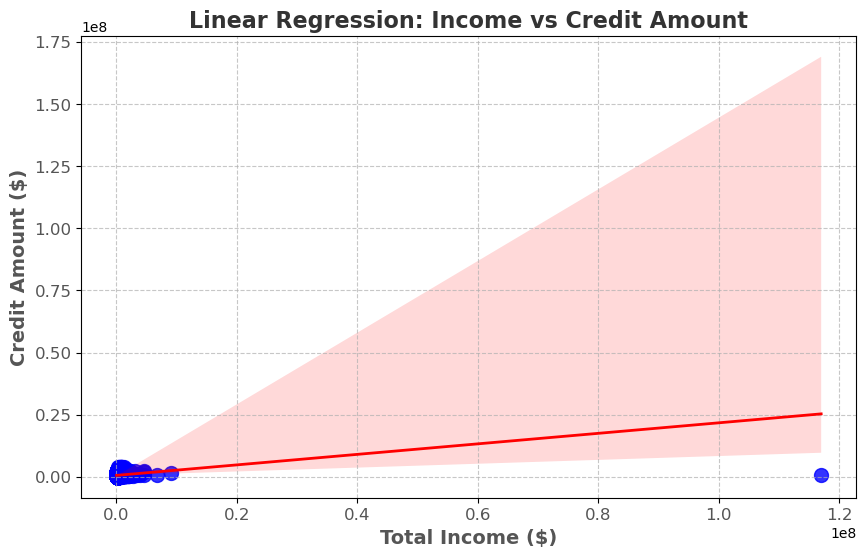

In [66]:
## is there relation between amount of income of clieant and total and AMT_CREDIT and paying the loan
plt.figure(figsize=(10, 6))  # Set the figure size
sns.regplot(x='AMT_INCOME_TOTAL', y='AMT_CREDIT', data=df, scatter_kws={'s':100, 'color':'blue'}, line_kws={'color':'red', 'linewidth':2})

# Customize the plot
plt.title('Linear Regression: Income vs Credit Amount', fontsize=16, fontweight='bold', color='#333333')
plt.xlabel('Total Income ($)', fontsize=14, fontweight='bold', color='#555555')
plt.ylabel('Credit Amount ($)', fontsize=14, fontweight='bold', color='#555555')
plt.grid(True, linestyle='--', alpha=0.7)  # Add grid with dashed lines
plt.xticks(fontsize=12, color='#555555')  # Customize x-axis tick labels
plt.yticks(fontsize=12, color='#555555')  # Customize y-axis tick labels

# Show the plot
plt.show()

## Income vs. Credit Amount 📈💵

**Insight: As income increases, the credit amount requested also tends to increase.** This indicates that individuals with higher income levels are more likely to request and potentially receive higher loan amounts. This relationship suggests that higher income can improve the chances of loan approval. 

### Key Takeaways:

- **Positive Correlation**: Higher income is associated with higher credit amounts. This trend shows that financial institutions may view higher-income clients as more reliable, potentially leading to increased loan approval chances. 🌟💼

- **Implication for Loan Approval**: If a client’s income is high, they are more likely to be approved for a larger loan amount. This can be attributed to the perceived lower risk associated with higher-income individuals. 📊✅

---------------------

## 📊 **Analysis of Loan Types and Payment Status**

### **Distribution of Loan Types by Payment Status**

**Objective:** 
To understand how different types of loans—**`Cash Loans`** and **`Revolving Loans`**—relate to loan defaults**.


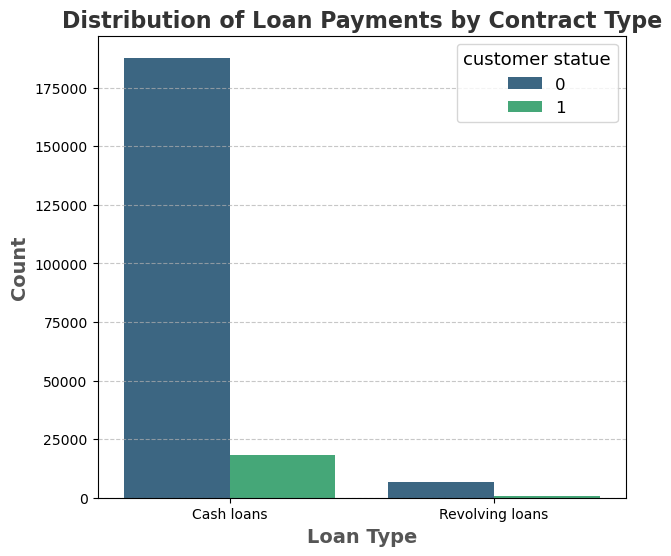

In [67]:
plt.figure(figsize=(15, 6))


plt.subplot(1, 2, 1)
sns.countplot(data=df, x='NAME_CONTRACT_TYPE', hue='TARGET', palette='viridis')


plt.title('Distribution of Loan Payments by Contract Type', fontsize=16, fontweight='bold', color='#333333')
plt.xlabel('Loan Type', fontsize=14, fontweight='bold', color='#555555')
plt.ylabel('Count', fontsize=14, fontweight='bold', color='#555555')
plt.legend(title='customer statue', title_fontsize='13', fontsize='12', loc='upper right')


plt.grid(axis='y', linestyle='--', alpha=0.7)


plt.show()

## Cash Loan Defaults 💸🚫

**Insight:** **The majority of individuals who demand cash loans end up defaulting on their payments.** This trend highlights a significant risk associated with cash loans.

### Key Points:

- **High Default Rate:** A large proportion of clients who apply for cash loans do not repay them, indicating a need for careful risk assessment. 📉🔍

In [68]:
print('-'*100)

----------------------------------------------------------------------------------------------------


## Marital Status and Loan Defaults 💍📊

**Analyzing the impact of marital status on loan defaults provides valuable insights into how personal circumstances influence financial behavior.**

### Key Insights:

- **Marital Status Distribution**: Understanding how different marital statuses relate to loan default rates helps identify risk factors and target demographics more effectively. 💡🔍

- **Default Rates by Marital Status**: Explore how the likelihood of defaulting on loans varies across different marital statuses. This can reveal patterns that may influence lending strategies. 📈💔

In [69]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,age_year,AGE_CATEGORY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.6341,0.0144,0.0000,0.0690,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.6243,0.0144,0.00,0.0690,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,"Stone, brick",2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,25,20-29
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.8040,0.0497,0.0806,0.0345,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.7987,0.0608,0.08,0.0345,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,Block,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,45,40-49
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,52,50-59
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Working,Secondary / secondary special,Single / not mar

In [70]:
## family_status_counts
family_status_counts_df = df['NAME_FAMILY_STATUS'].value_counts()


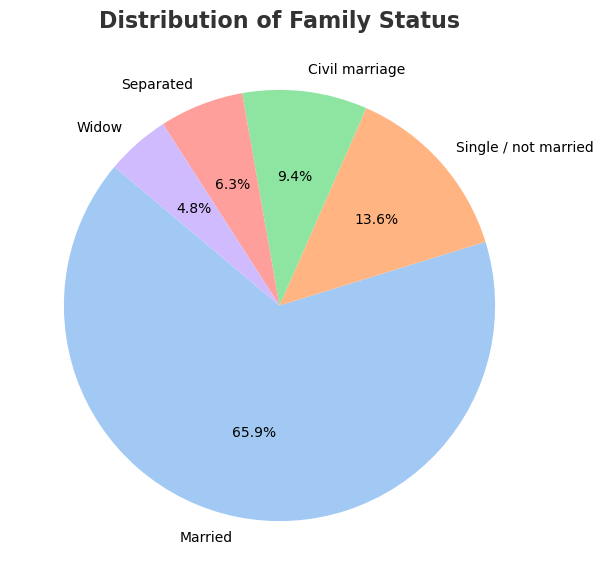

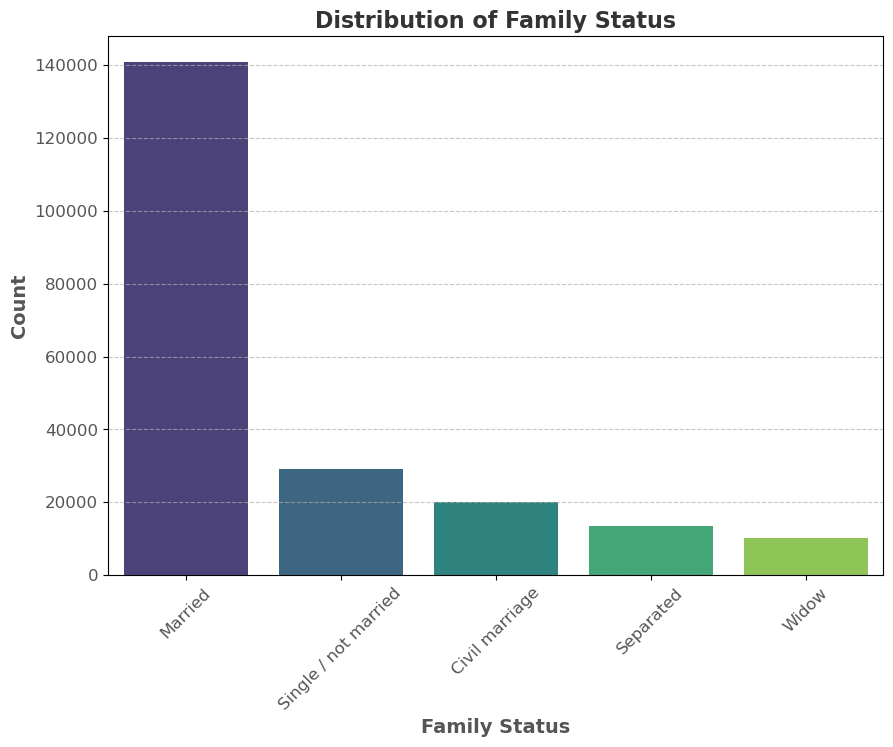

In [71]:
## count of applying for loans
plt.figure(figsize=(10, 7))
plt.pie(family_status_counts_df, labels=family_status_counts_df.index, autopct='%1.1f%%', colors=sns.color_palette("pastel"), startangle=140)
plt.title('Distribution of Family Status', fontsize=16, fontweight='bold', color='#333333')
plt.show()


plt.figure(figsize=(10, 7))
sns.barplot(x=family_status_counts_df.index, y=family_status_counts_df.values, palette="viridis")
plt.title('Distribution of Family Status', fontsize=16, fontweight='bold', color='#333333')
plt.xlabel('Family Status', fontsize=14, fontweight='bold', color='#555555')
plt.ylabel('Count', fontsize=14, fontweight='bold', color='#555555')
plt.xticks(rotation=45, fontsize=12, color='#555555')
plt.yticks(fontsize=12, color='#555555')
plt.grid(axis='y', linestyle='--', alpha=0.7) 
plt.show()

In [72]:
family_status_counts_df=family_status_counts_df.reset_index()

In [73]:
family_status_counts_df.columns=['NAME_FAMILY_STATUS','count']
family_status_counts_df

,NAME_FAMILY_STATUS,count
0,Married,140908
1,Single / not married,29156
2,Civil marriage,20025
3,Separated,13503
4,Widow,10272


## Family Status Distribution 📊

Here is the distribution of family status categories among the clients:

### **Distribution Data:**

- **Married**: 140,908 clients
- **Single / Not Married**: 29,156 clients
- **Civil Marriage**: 20,025 clients
- **Separated**: 13,503 clients
- **Widow**: 10,272 clients

### **Analysis:**

- **Married**: This category has the highest number of clients, with a total of **140,908**. This suggests that married individuals are the most prevalent group in the dataset. 💍
  
- **Single / Not Married**: The second largest group, with **29,156** clients. This group also represents a significant portion of the dataset. 🚶‍♂️

- **Civil Marriage**: With **20,025** clients, this group is slightly smaller but still represents a considerable portion of the population. 👩‍❤️‍👨

- **Separated**: This group consists of **13,503** clients. While smaller, it is still a notable portion of the dataset. 🔄

- **Widow**: The smallest group, with **10,272** clients. This indicates a lesser number compared to other categories. 🌹


In [74]:
family_status_counts = defaulted_on_loans['NAME_FAMILY_STATUS'].value_counts()
family_status_counts=family_status_counts.to_frame()
family_status_counts=family_status_counts.reset_index()
family_status_counts

,index,NAME_FAMILY_STATUS
0,Married,11881
1,Single / not married,3188
2,Civil marriage,2214
3,Separated,1267
4,Widow,736


In [75]:

family_status_counts.columns=['NAME_FAMILY_STATUS','count_defaulted']
family_status_counts

,NAME_FAMILY_STATUS,count_defaulted
0,Married,11881
1,Single / not married,3188
2,Civil marriage,2214
3,Separated,1267
4,Widow,736


In [76]:
all_data_married=family_status_counts_df.merge(family_status_counts,on='NAME_FAMILY_STATUS')
all_data_married['percentage']=all_data_married['count_defaulted']/all_data_married['count']
all_data_married=all_data_married.sort_values(by='percentage',ascending=False)
all_data_married

,NAME_FAMILY_STATUS,count,count_defaulted,percentage
2,Civil marriage,20025,2214,0.110562
1,Single / not married,29156,3188,0.109343
3,Separated,13503,1267,0.093831
0,Married,140908,11881,0.084317
4,Widow,10272,736,0.071651


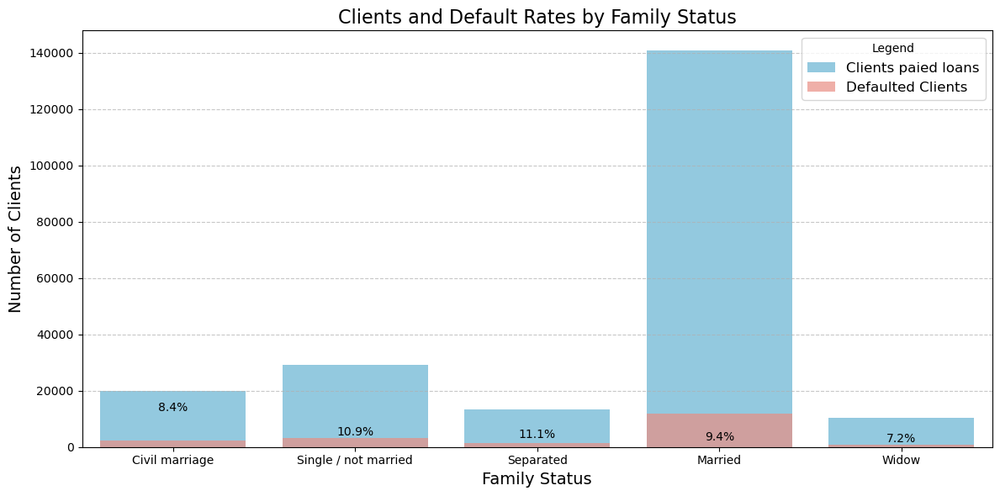

In [77]:
plt.figure(figsize=(12, 6))



sns.barplot(all_data_married,x='NAME_FAMILY_STATUS', y='count', color='skyblue', label='Clients paied loans')


sns.barplot(all_data_married,x='NAME_FAMILY_STATUS', y='count_defaulted',color='salmon', alpha=0.7, label='Defaulted Clients')


for index, row in all_data_married.iterrows():
    plt.text(index, row['count_defaulted'], f"{row['percentage']*100:.1f}%", 
             color='black', ha="center", va='bottom', fontsize=10)


plt.title('Clients and Default Rates by Family Status', fontsize=16)
plt.xlabel('Family Status', fontsize=14)
plt.ylabel('Number of Clients', fontsize=14)
plt.legend(title='Legend', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)


plt.tight_layout()
plt.show()


### **Key Insights of martial defaulting loans
** 🔍

1. **Civil Marriage** 💍
   - **High Default Rate**: Clients with a status of Civil Marriage have the highest default rate at 11.06%. This indicates that individuals in this category are slightly more likely to default compared to other family statuses.

2. **Single / Not Married** 👫
   - **Second Highest Default Rate**: The default rate for Single or Not Married individuals is 10.93%. This group also shows a relatively high likelihood of defaulting.

3. **Separated** 🕊️
   - **Moderate Default Rate**: Separated individuals have a default rate of 9.38%, suggesting a moderate risk of default.

4. **Married** 💑
   - **Lower Default Rate**: Married individuals have a default rate of 8.43%. This is lower compared to Civil Marriage and Single / Not Married, indicating a potentially more stable financial situation among this group.

5. **Widow** 👵
   - **Lowest Default Rate**: Clients who are widows have the lowest default rate at 7.17%. This may reflect more conservative financial behavior or different financial needs and responsibilities.

<h1 style="color: #2E86C1;"> 📊 Impact of Macroeconomic Factors on Loan Default Rates?</h1>

In [78]:
NAME_INCOME_TYPE=df['NAME_INCOME_TYPE'].value_counts()
NAME_INCOME_TYPE

Working                 110513
Commercial associate     50528
Pensioner                36765
State servant            16039
Student                     12
Unemployed                   4
Businessman                  2
Maternity leave              1
Name: NAME_INCOME_TYPE, dtype: int64

In [79]:
fig = px.pie(
    NAME_INCOME_TYPE,
    names=NAME_INCOME_TYPE.index,
    values=NAME_INCOME_TYPE.values,
    color='NAME_INCOME_TYPE',
    hole=0.3,  
    labels={'NAME_INCOME_TYPE': 'Income Type', 'Counts': 'Count'},  
    title='Distribution of customer work Types',  
    template='plotly_white',  
)

fig.update_layout(
    title_font_size=24,
    title_x=0.5,
    title_xanchor='center',
    title_yanchor='top',
    legend_title_text='Income Type',
    legend_title_font_size=16,
    legend_font_size=14,
    legend_font_color='black'
)


fig.update_traces(
    textinfo='label+percent',
    textfont_size=14,
    pull=[0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]  
)

fig.show()

## 📊 Distribution of Employment Types Among Loan Applicants

The table below illustrates the distribution of loan applicants based on their employment type. The percentages indicate each type's proportion relative to the total number of applicants.

| **Employment Type**      | **Count** | **Percentage** |
|--------------------------|-----------|----------------|
| 🏢 **Working**           | 110513   | 51.7%          |
| 💼 **Commercial associate** | 50528    | 23.6%          |
| 👴 **Pensioner**         | 36765    | 17.2%          |
| 🏛️ **State servant**     | 16039    | 7.5%           |
| 🎓 **Student**           | 12        | 0.00561%          |
| 🚶 **Unemployed**        | 4         | 0.00187%         |
| 👔 **Businessman**       | 2         | 0.000935%         |
| 🤰 **Maternity leave**   | 1         | 0.000468%         |

- **🏢 Working**: 110,513 individuals (51.7%)
- **💼 Commercial associate**: 50,528 individuals ( 23.6%)
- **👴 Pensioner**: 36,765 individuals (17.2%)
- **🏛️ State servant**: 16,039 individuals (7.5%)
- **🎓 Student**: 12 individuals ( 0.00561%)
- **🚶 Unemployed**: 4 individuals (0.00187%)
- **👔 Businessman**: 2 individuals (0.000935%)
- **🤰 Maternity leave**: 1 individual (0.000468%)

In [80]:
## count of work type for people which dont pay loans
defaulted_on_loans['NAME_INCOME_TYPE'].value_counts()

Working                 11703
Commercial associate     4196
Pensioner                2351
State servant            1036
Name: NAME_INCOME_TYPE, dtype: int64

In [81]:
defaulted_on_loans[defaulted_on_loans['NAME_INCOME_TYPE']=='Unemployed'].shape[0]

0

In [82]:
defaulted_on_loans[defaulted_on_loans['NAME_INCOME_TYPE']=='*Maternity leave'].shape[0]

0

- **<span style="color:red;">Unemployed</span>** and **<span style="color:red;">Maternity leave</span>** are highlighted to indicate that they typically do not pay loans.
- **<span style="color:orange;">Pensioner</span>** is highlighted to show a different context but they are generally known to be regular in payments.

# 4- PREPROCESSING FOR Modeling

In [84]:
## Encode Data

In [85]:
from sklearn.preprocessing import LabelEncoder
categorical_cols = df.select_dtypes(include=['object']).columns

label_encoders = {}

for col in categorical_cols:
    label_encoder = LabelEncoder()
    df[col] = label_encoder.fit_transform(df[col])
    label_encoders[col] = label_encoder

print("Data after label encoding:")
df.head()

Data after label encoding:


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,age_year,AGE_CATEGORY
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,351000.0,7,4,3,1,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,6,10,0,0,0,0,0,0,5,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.6341,0.0144,0.0000,0.0690,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.6243,0.0144,0.00,0.0690,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,2,0,5,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,25,20-29
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,1129500.0,4,1,1,1,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,1,11,0,0,0,0,0,0,39,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.8040,0.0497,0.0806,0.0345,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.7987,0.0608,0.08,0.0345,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,2,0,0,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,45,40-49
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,135000.0,7,4,3,1,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,1,9,0,0,0,0,0,0,11,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,3,7,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,52,50-59
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,513000.0,7,4,3,1,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,4,11,0,0,0,0,1,1,37,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,3,7,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,54,50-59
5,100008,0,0,1,0,1,0,99000.0,490495.5,27517.5,454500

In [86]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 213864 entries, 0 to 307510
Columns: 116 entries, SK_ID_CURR to AGE_CATEGORY
dtypes: category(1), float64(60), int32(14), int64(41)
memory usage: 178.1 MB


In [87]:
## now all data is encoded

In [93]:
# except column age category
df=df.iloc[:,:-1]

In [94]:
## filling na by mean 
df.fillna(np.mean,inplace=True)

In [95]:
float_df=df.select_dtypes(include=[float]).columns
for i in float_df:
    df[i]=df[i].astype('int')

In [96]:
numeric_df=df.select_dtypes(include=[int])

In [97]:
#

In [98]:
X = numeric_df.loc[:, (numeric_df.columns != 'TARGET')]

In [100]:
y=df['TARGET']


In [101]:
## checking for imbalned data 

In [102]:
target_count=df['TARGET'].value_counts()
target_count

0    194578
1     19286
Name: TARGET, dtype: int64

In [103]:
fig=px.pie(target_count,names=target_count.index,values=target_count.values,color_discrete_sequence=['blue','red'])
fig.update_layout(title='The count of 0 and 1 on Target column'
)

**- As we see there imbalanced data**

## before treating imbalanced data

In [104]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,stratify=y)

## Hyper parameter tuning 

In [105]:
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in range(5)]


In [106]:
random_grid = {
    'max_features': max_features,
    'max_depth': max_depth,
}

In [107]:
clf_before_process = RandomForestClassifier(random_state=42)
clf_before_process

RandomForestClassifier(random_state=42)

In [108]:
rf_random = RandomizedSearchCV(
    estimator=clf_before_process, 
    param_distributions=random_grid, 
    n_iter=100, 
    cv=3, 
    verbose=2, 
    random_state=42, 
)

In [109]:
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END .....................max_depth=0, max_features=auto; total time=   0.1s
[CV] END .....................max_depth=0, max_features=auto; total time=   0.1s
[CV] END .....................max_depth=0, max_features=auto; total time=   0.1s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.1s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.1s
[CV] END .....................max_depth=1, max_features=auto; total time=   9.1s
[CV] END .....................max_depth=1, max_features=auto; total time=   9.1s
[CV] END .....................max_depth=1, max_features=auto; total time=   8.7s
[CV] END .....................max_depth=1, max_features=sqrt; total time=   9.0s
[CV] END .....................max_depth=1, max_features=sqrt; total time=   9.2s
[CV] END .....................max_depth=1, max_f

RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(random_state=42),
                   n_iter=100,
                   param_distributions={'max_depth': [0, 1, 2, 3, 4],
                                        'max_features': ['auto', 'sqrt']},
                   random_state=42, verbose=2)

In [110]:
## best parameters 
rf_random.best_params_

{'max_features': 'auto', 'max_depth': 1}

In [111]:
clf_before_process = RandomForestClassifier(max_features='auto',max_depth=1)
clf_before_process

RandomForestClassifier(max_depth=1, max_features='auto')

In [112]:
clf_before_process.fit(X_train,y_train)

RandomForestClassifier(max_depth=1, max_features='auto')

In [113]:
y_pred_b=clf_before_process.predict(X_test)

In [114]:
accuracy=accuracy_score(y_test,y_pred_b)
accuracy

0.9098262922871905

In [115]:
report = classification_report(y_test, y_pred_b)
print(report)

              precision    recall  f1-score   support

           0       0.91      1.00      0.95     38916
           1       0.00      0.00      0.00      3857

    accuracy                           0.91     42773
   macro avg       0.45      0.50      0.48     42773
weighted avg       0.83      0.91      0.87     42773



In [116]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_b))
print("Precision:", precision_score(y_test, y_pred_b))
print("Recall:", recall_score(y_test, y_pred_b))
print("F1 Score:", f1_score(y_test, y_pred_b))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_b))

Random Forest Metrics:
Accuracy: 0.9098262922871905
Precision: 0.0
Recall: 0.0
F1 Score: 0.0
Confusion Matrix:
 [[38916     0]
 [ 3857     0]]


## Classification Report Breakdown

**Class 0 (Non-default):**
- **Precision: 0.91**: Of all the samples predicted as class 0, 91% were correctly predicted (true positives out of all predicted positives).
- **Recall: 1.00**: Of all the actual samples of class 0, 100% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.95**: The harmonic mean of precision and recall, indicating a balance between the two.
- **Support: 38,916**: The number of actual instances of class 0 in the dataset.

**Class 1 (Default):**
- **Precision: 0.00**: None of the samples predicted as class 1 were correct (no true positives).
- **Recall: 0.00**: None of the actual samples of class 1 were correctly identified (no true positives).
- **F1-Score: 0.00**: The harmonic mean of precision and recall, which is zero due to the poor performance.
- **Support: 3,857**: The number of actual instances of class 1 in the dataset.

**Overall Metrics:**
- **Accuracy: 0.91**: The model achieves an accuracy of 91%, which is the percentage of correctly predicted instances (whether predicted as class 0 or 1) out of the total instances in the dataset.
- **Macro Average:**
  - **Precision: 0.45**: The average precision across both classes, giving equal weight to each class.
  - **Recall: 0.50**: The average recall across both classes, giving equal weight to each class.
  - **F1-Score: 0.48**: The average F1-score across both classes, giving equal weight to each class.
- **Weighted Average:**
  - **Precision: 0.83**: The weighted average precision, taking into account the support (number of instances) of each class.
  - **Recall: 0.91**: The weighted average recall, taking into account the support (number of instances) of each class.
  - **F1-Score: 0.87**: The weighted average F1-score, taking into account the support (number of instances) of each class.

## confusion matrix

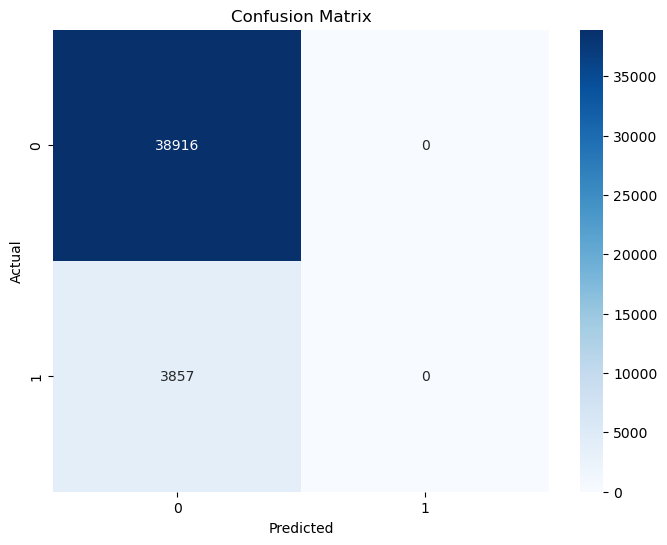

In [117]:
conf_matrix_R = confusion_matrix(y_test, y_pred_b)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_R, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

True Positives (TP): 38916 - The model correctly predicted 38916 instances of class 0.

False Positives (FP): 0 - The model incorrectly predicted 0 instances of class 0 when they were actually instances of class 1.

True Negatives (TN): 3857 - The model correctly predicted 3857 instances of class 1.

False Negatives (FN): 0 - The model incorrectly predicted 0 instances of class 1 when they were actually instances of class 0.

In [118]:
## After processing 

## Treat outliers 

In [119]:
## knowing if there outliers 

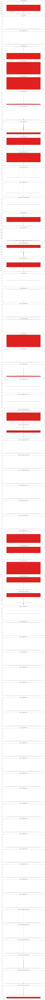

In [120]:
num_features = len(numeric_df.columns)

plt.figure(figsize=(15, num_features * 5))


for i, column in enumerate(numeric_df.columns, 1):
    plt.subplot(num_features, 1, i)  
    sns.boxplot(data=numeric_df[column],color='red')
    plt.title(f'Boxplot of {column}')

plt.tight_layout()

plt.show()

In [121]:
## the majority of columns contains outliers so i treat the outliers

In [122]:
def treat_outliers(dataFrame,x):
    Q1=dataFrame[x].quantile(0.25)
    Q3=dataFrame[x].quantile(0.75)
    IQR=Q3-Q1
    lower_Bound=Q3-1.5*IQR
    upper_Bound=Q3+1.5*IQR
    z=dataFrame[x].clip(lower_Bound,upper_Bound)
    return z


In [123]:
for i in numeric_df.columns:
    numeric_df[i]=treat_outliers(numeric_df,i)

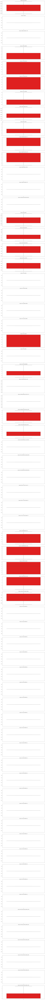

In [124]:
num_features = len(numeric_df.columns)

plt.figure(figsize=(15, num_features * 5))


for i, column in enumerate(numeric_df.columns, 1):
    plt.subplot(num_features, 1, i)  
    sns.boxplot(data=numeric_df[column],color='red')
    plt.title(f'Boxplot of {column}')

plt.tight_layout()

plt.show()

In [125]:
## outliers is done 


## Scailing 

In [126]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)

X_test_scaled = scaler.transform(X_test)


In [127]:
smote_after= SMOTE(random_state=42)
X_resampled_after, y_resampled_after = smote_after.fit_resample(X_train_scaled, y_train)

In [128]:
y_resampled_after.value_counts()

0    155662
1    155662
Name: TARGET, dtype: int64

## Feature Selection by Select k_best 

In [130]:
## select feature
selector = SelectKBest(f_classif, k=60)
X_train_selected = selector.fit_transform(X_resampled_after, y_resampled_after)
X_test_selected = selector.transform(X_test_scaled)
selected_features = X.columns[selector.get_support()]
selected_features

Index(['SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
       'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION',
       'DAYS_ID_PUBLISH', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE',
       'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
       'ORGANIZATION_TYPE', 'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE',
       'WALLSMATERIAL_MODE', 'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_3',
       'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6',
       'FLAG_DOCUMENT_7', 'FLAG_DOCUME

## Random Forest After prerprecessing

In [131]:

clf_random_A = RandomForestClassifier(n_estimators=100,random_state=42)

## Hyper parameter tutning

In [132]:
rf_random_A = RandomizedSearchCV(
    estimator=clf_random_A, 
    param_distributions=random_grid, 
    n_iter=100, 
    cv=3, 
    verbose=2, 
    random_state=42, 
)

In [133]:
rf_random_A.fit(X_train_selected, y_resampled_after)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END .....................max_depth=0, max_features=auto; total time=   0.0s
[CV] END .....................max_depth=0, max_features=auto; total time=   0.0s
[CV] END .....................max_depth=0, max_features=auto; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=1, max_features=auto; total time=  23.7s
[CV] END .....................max_depth=1, max_features=auto; total time=  22.9s
[CV] END .....................max_depth=1, max_features=auto; total time=  23.0s
[CV] END .....................max_depth=1, max_features=sqrt; total time=  24.4s
[CV] END .....................max_depth=1, max_features=sqrt; total time=  12.0s
[CV] END .....................max_depth=1, max_f

RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(random_state=42),
                   n_iter=100,
                   param_distributions={'max_depth': [0, 1, 2, 3, 4],
                                        'max_features': ['auto', 'sqrt']},
                   random_state=42, verbose=2)

In [134]:
## selected feature
rf_random_A.best_params_

{'max_features': 'auto', 'max_depth': 4}

In [135]:
clf_random_A = RandomForestClassifier(n_estimators=100,random_state=42,max_features ='auto', max_depth=4)

In [136]:
clf_random_A.fit(X_train_selected, y_resampled_after)


RandomForestClassifier(max_depth=4, max_features='auto', random_state=42)

In [137]:
y_pred_clf = clf_random_A.predict(X_test_selected)

In [138]:
accuracy_random_clf = accuracy_score(y_test, y_pred_clf)
accuracy_random_clf

0.6808266897341781

In [139]:
report_clf = classification_report(y_test, y_pred_clf)

print("Classification Report:\n", report_clf)

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.71      0.80     38916
           1       0.12      0.42      0.19      3857

    accuracy                           0.68     42773
   macro avg       0.52      0.56      0.50     42773
weighted avg       0.85      0.68      0.75     42773



## Classification Report Breakdown

**Class 0 (Non-default):**
- **Precision: 0.92**: Of all the samples predicted as class 0, 92% were correctly predicted (true positives out of all predicted positives).
- **Recall: 0.71**: Of all the actual samples of class 0, 71% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.80**: The harmonic mean of precision and recall, indicating a balance between the two.
- **Support: 38,916**: The number of actual instances of class 0 in the dataset.

**Class 1 (Default):**
- **Precision: 0.12**: Only 12% of the samples predicted as class 1 were correct (true positives out of all predicted positives).
- **Recall: 0.42**: 42% of the actual samples of class 1 were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.19**: The harmonic mean of precision and recall, indicating poor performance in this class.
- **Support: 3,857**: The number of actual instances of class 1 in the dataset.

**Overall Metrics:**
- **Accuracy: 0.68**: The model achieves an accuracy of 68%, which is the percentage of correctly predicted instances (whether predicted as class 0 or 1) out of the total instances in the dataset.
- **Macro Average:**
  - **Precision: 0.52**: The average precision across both classes, giving equal weight to each class.
  - **Recall: 0.56**: The average recall across both classes, giving equal weight to each class.
  - **F1-Score: 0.50**: The average F1-score across both classes, giving equal weight to each class.
- **Weighted Average:**
  - **Precision: 0.85**: The weighted average precision, taking into account the support (number of instances) of each class.
  - **Recall: 0.68**: The weighted average recall, taking into account the support (number of instances) of each class.
  - **F1-Score: 0.75**: The weighted average F1-score, taking into account the support (number of instances) of each class.

In [140]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_clf))
print("Precision:", precision_score(y_test, y_pred_clf))
print("Recall:", recall_score(y_test, y_pred_clf))
print("F1 Score:", f1_score(y_test, y_pred_clf))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_clf))

Random Forest Metrics:
Accuracy: 0.6808266897341781
Precision: 0.12387681437677597
Recall: 0.4182006740990407
F1 Score: 0.19113639056760276
Confusion Matrix:
 [[27508 11408]
 [ 2244  1613]]


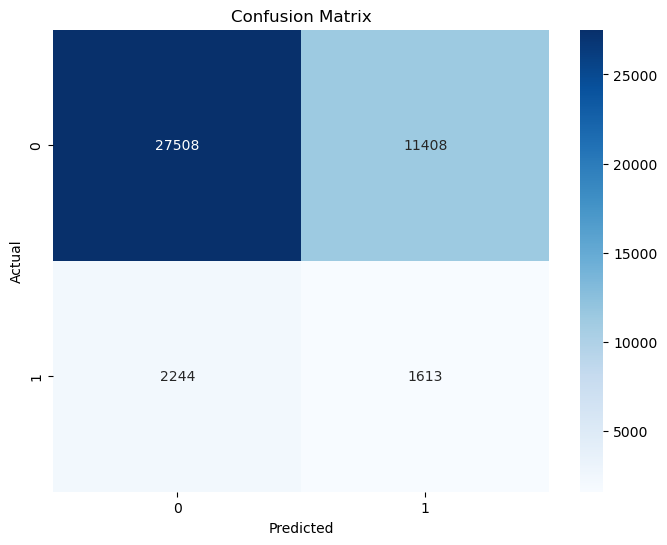

In [141]:
## representing by heatmap 
conf_matrix_R = confusion_matrix(y_test, y_pred_clf)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_R, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

True Positives (TP): 1613 - The model correctly predicted 38916 instances of class 0.

False Positives (FP): 11408 - The model incorrectly predicted 0 instances of class 0 when they were actually instances of class 1.

True Negatives (TN): 2244 - The model correctly predicted 3857 instances of class 1.

False Negatives (FN): 27508 - The model incorrectly predicted 0 instances of class 1 when they were actually instances of class 0.

**F1 score increases Unlike the model before processing**

---------------------------------------------

## Applying Robust Scaler

In [142]:
## Robust scaler on random forest
scaler = RobustScaler()
X_train_scaled_R = scaler.fit_transform(X_train)
X_test_scaled_R = scaler.transform(X_test)

In [143]:
smote_after_r= SMOTE(random_state=42)
X_resampled_after_r, y_resampled_after_r = smote_after_r.fit_resample(X_train_scaled_R, y_train)

In [144]:
## applying robust scaler
selector = SelectKBest(f_classif, k=40)
X_train_selected = selector.fit_transform(X_resampled_after_r, y_resampled_after_r)
X_test_selected = selector.transform(X_test_scaled_R)
selected_features_r = X.columns[selector.get_support()]
selected_features_r

Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'AMT_CREDIT',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_HOUSING_TYPE',
       'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
       'ORGANIZATION_TYPE', 'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE',
       'WALLSMATERIAL_MODE', 'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_3',
       'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_11',
       'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_18', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT'],
      dtype='object')

In [145]:
clf_random_r = RandomForestClassifier(n_estimators=100,random_state=42,class_weight='balanced')

In [146]:
rf_random_r_g = RandomizedSearchCV(
    estimator=clf_random_r, 
    param_distributions=random_grid, 
    n_iter=100, 
    cv=3, 
    verbose=2, 
    random_state=42, 
)

In [147]:
rf_random_r_g.fit(X_train_selected,y_resampled_after_r)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END .....................max_depth=0, max_features=auto; total time=   0.0s
[CV] END .....................max_depth=0, max_features=auto; total time=   0.0s
[CV] END .....................max_depth=0, max_features=auto; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=0, max_features=sqrt; total time=   0.0s
[CV] END .....................max_depth=1, max_features=auto; total time=   5.7s
[CV] END .....................max_depth=1, max_features=auto; total time=   7.0s
[CV] END .....................max_depth=1, max_features=auto; total time=   7.4s
[CV] END .....................max_depth=1, max_features=sqrt; total time=   6.7s
[CV] END .....................max_depth=1, max_features=sqrt; total time=   6.4s
[CV] END .....................max_depth=1, max_f

RandomizedSearchCV(cv=3,
                   estimator=RandomForestClassifier(class_weight='balanced',
                                                    random_state=42),
                   n_iter=100,
                   param_distributions={'max_depth': [0, 1, 2, 3, 4],
                                        'max_features': ['auto', 'sqrt']},
                   random_state=42, verbose=2)

In [148]:
rf_random_r_g.best_params_

{'max_features': 'auto', 'max_depth': 4}

In [149]:
rf_random_r=RandomForestClassifier(n_estimators=100,random_state=42,class_weight='balanced',max_features='auto',max_depth=4)

In [150]:
rf_random_r.fit(X_train_selected,y_resampled_after_r)

RandomForestClassifier(class_weight='balanced', max_depth=4,
                       max_features='auto', random_state=42)

In [151]:
y_pred_clf_r = rf_random_r.predict(X_test_selected)

In [152]:
accuracy_random_clf_r = accuracy_score(y_test, y_pred_clf_r)
accuracy_random_clf_r

0.7023823440020573

In [153]:
report_clf = classification_report(y_test, y_pred_clf_r)

print("Classification Report:\n", report_clf)

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.73      0.82     38916
           1       0.14      0.44      0.21      3857

    accuracy                           0.70     42773
   macro avg       0.53      0.58      0.51     42773
weighted avg       0.86      0.70      0.76     42773



**Class 0 (Non-default):**
- **Precision: 0.93**: Of all the samples predicted as class 0, 93% were correctly predicted (true positives out of all predicted positives).
- **Recall: 0.73**: Of all the actual samples of class 0, 73% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.82**: The harmonic mean of precision and recall, indicating a balance between the two.
- **Support: 38,916**: The number of actual instances of class 0 in the dataset.

**Class 1 (Default):**
- **Precision: 0.14**: Only 14% of the samples predicted as class 1 were correct (true positives out of all predicted positives).
- **Recall: 0.44**: 44% of the actual samples of class 1 were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.21**: The harmonic mean of precision and recall, indicating poor performance in this class.
- **Support: 3,857**: The number of actual instances of class 1 in the dataset.

**Overall Metrics:**
- **Accuracy: 0.70**: The model achieves an accuracy of 70%, which is the percentage of correctly predicted instances (whether predicted as class 0 or 1) out of the total instances in the dataset.
- **Macro Average:**
  - **Precision: 0.53**: The average precision across both classes, giving equal weight to each class.
  - **Recall: 0.58**: The average recall across both classes, giving equal weight to each class.
  - **F1-Score: 0.51**: The average F1-score across both classes, giving equal weight to each class.
- **Weighted Average:**
  - **Precision: 0.86**: The weighted average precision, taking into account the support (number of instances) of each class.
  - **Recall: 0.70**: The weighted average recall, taking into account the support (number of instances) of each class.
  - **F1-Score: 0.76**: The weighted average F1-score, taking into account the support (number of instances) of each class.

## Classification Report Breakdown

**Class 0 (Non-default):**
- **Precision: 0.93**: Of all the samples predicted as class 0, 93% were correctly predicted (true positives out of all predicted positives).
- **Recall: 0.62**: Of all the actual samples of class 0, 62% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.74**: The harmonic mean of precision and recall, indicating a balance between the two.
- **Support: 38,916**: The number of actual instances of class 0 in the dataset.

**Class 1 (Default):**
- **Precision: 0.12**: Of all the samples predicted as class 1, 12% were correctly predicted (true positives out of all predicted positives).
- **Recall: 0.55**: Of all the actual samples of class 1, 55% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.20**: The harmonic mean of precision and recall, indicating a balance between the two.
- **Support: 3,857**: The number of actual instances of class 1 in the dataset.

**Overall Metrics:**
- **Accuracy: 0.61**: The model achieves an accuracy of 61%, which is the percentage of correctly predicted instances (whether predicted as class 0 or 1) out of the total instances in the dataset.
- **Macro Average:**
  - **Precision: 0.53**: The average precision across both classes, giving equal weight to each class.
  - **Recall: 0.58**: The average recall across both classes, giving equal weight to each class.
  - **F1-Score: 0.47**: The average F1-score across both classes, giving equal weight to each class.
- **Weighted Average:**
  - **Precision: 0.86**: The weighted average precision, taking into account the support (number of instances) of each class.
  - **Recall: 0.61**: The weighted average recall, taking into account the support (number of instances) of each class.
  - **F1-Score: 0.69**: The weighted average F1-score, taking into account the support (number of instances) of each class.

In [154]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_clf_r))
print("Precision:", precision_score(y_test, y_pred_clf_r))
print("Recall:", recall_score(y_test, y_pred_clf_r))
print("F1 Score:", f1_score(y_test, y_pred_clf_r))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_clf_r))

Random Forest Metrics:
Accuracy: 0.7023823440020573
Precision: 0.13768885259289507
Recall: 0.43712730101114855
F1 Score: 0.2094149795056515
Confusion Matrix:
 [[28357 10559]
 [ 2171  1686]]


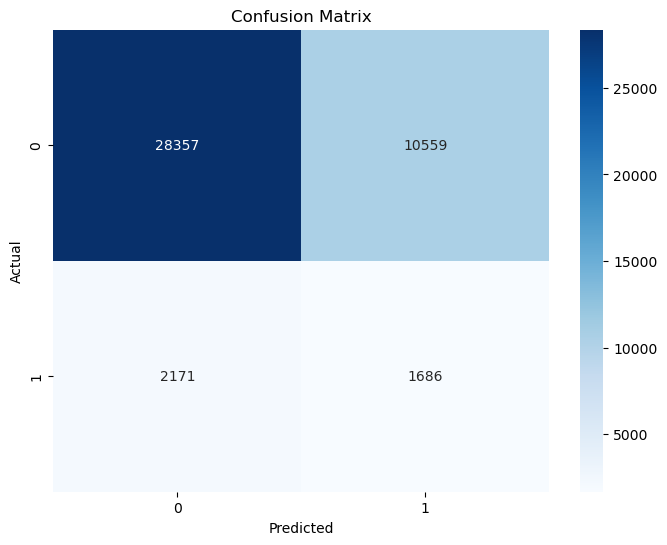

In [155]:
conf_matrix_r = confusion_matrix(y_test, y_pred_clf_r)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_r, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

True Positives (TP): 1661 - The model correctly predicted 38916 instances of class 0.

False Positives (FP): 2171 - The model incorrectly predicted 0 instances of class 0 when they were actually instances of class 1.

True Negatives (TN): 10559 - The model correctly predicted 3857 instances of class 1.

False Negatives (FN): 28375 - The model incorrectly predicted 0 instances of class 1 when they were actually instances of class 0.

**F1 score increases Unlike the model before processing**

**F1 score increases after applying robust scaler**

**False negative refer that you predict negative but in actual this predict is false** 

## applying smote by diffrent percentage 

In [156]:
smote_after_p= SMOTE(random_state=42,sampling_strategy=0.40)
X_resampled_after_p, y_resampled_after_p = smote_after_p.fit_resample(X_train_scaled_R, y_train)

In [157]:
selector = SelectKBest(f_classif, k=40)
X_train_selected = selector.fit_transform(X_resampled_after_p, y_resampled_after_p)
X_test_selected = selector.transform(X_test_scaled_R)
selected_features_p = X.columns[selector.get_support()]
selected_features_p

Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'AMT_CREDIT',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_HOUSING_TYPE',
       'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'HOUR_APPR_PROCESS_START', 'LIVE_REGION_NOT_WORK_REGION',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'FONDKAPREMONT_MODE',
       'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'DAYS_LAST_PHONE_CHANGE',
       'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_8',
       'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14',
       'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_18',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object')

In [158]:
clf_random_p = RandomForestClassifier(n_estimators=100,random_state=42,class_weight='balanced',max_features='auto',max_depth=4)

In [159]:
clf_random_p.fit(X_train_selected,y_resampled_after_p)

RandomForestClassifier(class_weight='balanced', max_depth=4,
                       max_features='auto', random_state=42)

In [160]:
y_pred_clf_p = clf_random_p.predict(X_test_selected)

In [161]:
accuracy_random_clf_p = accuracy_score(y_test, y_pred_clf_p)
accuracy_random_clf_p

0.6708671358099736

In [162]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_clf_p))
print("Precision:", precision_score(y_test, y_pred_clf_p))
print("Recall:", recall_score(y_test, y_pred_clf_p))
print("F1 Score:", f1_score(y_test, y_pred_clf_p))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_clf_p))

Random Forest Metrics:
Accuracy: 0.6708671358099736
Precision: 0.13018308126492512
Recall: 0.4664246823956443
F1 Score: 0.20355284000905186
Confusion Matrix:
 [[26896 12020]
 [ 2058  1799]]


In [163]:
report_clf_p = classification_report(y_test, y_pred_clf_p)

print("Classification Report:\n", report_clf_p)

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.69      0.79     38916
           1       0.13      0.47      0.20      3857

    accuracy                           0.67     42773
   macro avg       0.53      0.58      0.50     42773
weighted avg       0.86      0.67      0.74     42773



## Classification Report Breakdown

- **Precision: 0.93**: Of all the samples predicted as class 0, 93% were correctly predicted (true positives out of all predicted positives).
- **Recall: 0.69**: Of all the actual samples of class 0, 69% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.79**: The harmonic mean of precision and recall, indicating a balance between the two.
- **Support: 38,916**: The number of actual instances of class 0 in the dataset.

**Class 1 (Default):**
- **Precision: 0.13**: Only 13% of the samples predicted as class 1 were correct (true positives out of all predicted positives).
- **Recall: 0.47**: 47% of the actual samples of class 1 were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.20**: The harmonic mean of precision and recall, indicating poor performance in this class.
- **Support: 3,857**: The number of actual instances of class 1 in the dataset.

**Overall Metrics:**
- **Accuracy: 0.67**: The model achieves an accuracy of 67%, which is the percentage of correctly predicted instances (whether predicted as class 0 or 1) out of the total instances in the dataset.
- **Macro Average:**
  - **Precision: 0.53**: The average precision across both classes, giving equal weight to each class.
  - **Recall: 0.58**: The average recall across both classes, giving equal weight to each class.
  - **F1-Score: 0.50**: The average F1-score across both classes, giving equal weight to each class.
- **Weighted Average:**
  - **Precision: 0.86**: The weighted average precision, taking into account the support (number of instances) of each class.
  - **Recall: 0.67**: The weighted average recall, taking into account the support (number of instances) of each class.
  - **F1-Score: 0.74**: The weighted average F1-score, taking into account the support (number of instances) of each class.

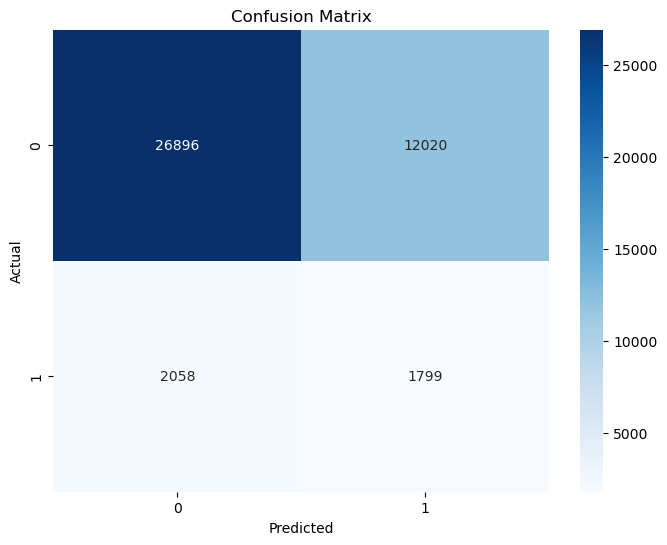

In [164]:
conf_matrix_s = confusion_matrix(y_test, y_pred_clf_p)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_s, annot=True, fmt='d', cmap='Blues')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

True Positives (TP): 1799 - The model correctly predicted 38916 instances of class 0.

False Positives (FP): 12020 - The model incorrectly predicted 0 instances of class 0 when they were actually instances of class 1.

True Negatives (TN): 2058 - The model correctly predicted 3857 instances of class 1.

False Negatives (FN): 26896 - The model incorrectly predicted 0 instances of class 1 when they were actually instances of class 0.

**F1 score decreases after applying robust scaler**

**False negative refer that you predict negative but in actual this predict is false , it is high percentage** 

## XGBOOST

In [165]:
clf_XG = xgb.XGBClassifier(scale_pos_weight=(len(y_train) - sum(y_train)) / sum(y_train), random_state=42)


## Hyper Parameter Tuning on XGboost

In [166]:
param_dist = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, 7]}

In [167]:
clf_XG_r_g = RandomizedSearchCV(
    estimator=clf_XG, 
    param_distributions=param_dist, 
    n_iter=100, 
    cv=3, 
    verbose=2, 
    random_state=42, 
)

In [168]:
clf_XG_r_g.fit(X_train_selected, y_resampled_after_p)

Fitting 3 folds for each of 6 candidates, totalling 18 fits
[CV] END .......................max_depth=3, n_estimators=50; total time=   1.2s
[CV] END .......................max_depth=3, n_estimators=50; total time=   0.4s
[CV] END .......................max_depth=3, n_estimators=50; total time=   0.4s
[CV] END ......................max_depth=3, n_estimators=100; total time=   0.8s
[CV] END ......................max_depth=3, n_estimators=100; total time=   0.7s
[CV] END ......................max_depth=3, n_estimators=100; total time=   0.7s
[CV] END .......................max_depth=5, n_estimators=50; total time=   0.6s
[CV] END .......................max_depth=5, n_estimators=50; total time=   0.6s
[CV] END .......................max_depth=5, n_estimators=50; total time=   0.6s
[CV] END ......................max_depth=5, n_estimators=100; total time=   1.1s
[CV] END ......................max_depth=5, n_estimators=100; total time=   1.0s
[CV] END ......................max_depth=5, n_est

RandomizedSearchCV(cv=3,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate...
                                           max_cat_threshold=None,
                                           max_cat_to_onehot=None,
                                           max_delta_step=None, max_depth=None,
                                           max_leaves=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints=None,
                                           multi_strategy=None,
                                           n_estimators=None, n_jobs=None,
                                           num_parallel_tree=None,
                                           random_state=42, ...),
                   n_iter=100,
                   param_distributions={'max_depth': [3, 5, 7],
                                        'n_estimators': [50, 100]},
                   random_state=42, verbose=2)

In [169]:
clf_XG_r_g.best_params_

{'n_estimators': 100, 'max_depth': 7}

In [170]:
clf_XG = xgb.XGBClassifier(scale_pos_weight=(len(y_train) - sum(y_train)) / sum(y_train), random_state=42,n_estimators=100,max_depth=7)

In [171]:
clf_XG.fit(X_train_selected, y_resampled_after_p)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=100, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [172]:
y_pred_xg=clf_XG.predict(X_test_selected)

In [173]:
accuracy_random_clf_xg = accuracy_score(y_test, y_pred_xg)
accuracy_random_clf_xg

0.6602062048488533

In [174]:
print("Random Forest Metrics:")
print("Accuracy:", accuracy_score(y_test, y_pred_xg))
print("Precision:", precision_score(y_test, y_pred_xg))
print("Recall:", recall_score(y_test, y_pred_xg))
print("F1 Score:", f1_score(y_test, y_pred_xg))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_xg))

Random Forest Metrics:
Accuracy: 0.6602062048488533
Precision: 0.14317224784439542
Recall: 0.5553539019963702
F1 Score: 0.22765437347220746
Confusion Matrix:
 [[26097 12819]
 [ 1715  2142]]


In [175]:
report_clf_xg = classification_report(y_test, y_pred_xg)

print("Classification Report:\n", report_clf_xg)

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.67      0.78     38916
           1       0.14      0.56      0.23      3857

    accuracy                           0.66     42773
   macro avg       0.54      0.61      0.50     42773
weighted avg       0.87      0.66      0.73     42773




### Classification Report Summary

## Classification Report Breakdown

**Class 0 (Non-default):**
- **Precision: 0.94**: Of all the samples predicted as class 0, 94% were correctly predicted (true positives out of all predicted positives).
- **Recall: 0.67**: Of all the actual samples of class 0, 67% were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.78**: The harmonic mean of precision and recall, indicating a good balance between the two.
- **Support: 38,916**: The number of actual instances of class 0 in the dataset.

**Class 1 (Default):**
- **Precision: 0.14**: Only 14% of the samples predicted as class 1 were correct (true positives out of all predicted positives).
- **Recall: 0.56**: 56% of the actual samples of class 1 were correctly identified (true positives out of all actual positives).
- **F1-Score: 0.23**: The harmonic mean of precision and recall, indicating poor performance in this class.
- **Support: 3,857**: The number of actual instances of class 1 in the dataset.

**Overall Metrics:**
- **Accuracy: 0.66**: The model achieves an accuracy of 66%, which is the percentage of correctly predicted instances (whether predicted as class 0 or 1) out of the total instances in the dataset.
- **Macro Average:**
  - **Precision: 0.54**: The average precision across both classes, giving equal weight to each class.
  - **Recall: 0.61**: The average recall across both classes, giving equal weight to each class.
  - **F1-Score: 0.50**: The average F1-score across both classes, giving equal weight to each class.
- **Weighted Average:**
  - **Precision: 0.87**: The weighted average precision, taking into account the support (number of instances) of each class.
  - **Recall: 0.66**: The weighted average recall, taking into account the support (number of instances) of each

## Evaluation matrix  

In [176]:
## Evaluation matrix here is f1 score 

## comparison between models 

In [190]:
comparison=pd.DataFrame({'model':['Random forest before preporocessing','Random forest after preporocessing','Random forest after preprocessing with robust scaaler','Random forest BY SMOTE percentage','Xgboost','Ranom_forest_under sampling']
    ,'f1_score':[0,0.2016,0.21,0.2020,0.17,0.]
}
)

In [191]:
comparison=comparison.sort_values(by='f1_score',ascending=False)
comparison

,model,f1_score
5,Ranom_forest_under sampling,0.2200
2,Random forest after preprocessing with robust ...,0.2100
3,Random forest BY SMOTE percentage,0.2020
1,Random forest after preporocessing,0.2016
4,Xgboost,0.1700
0,Random forest before preporocessing,0.0000


<Axes: >

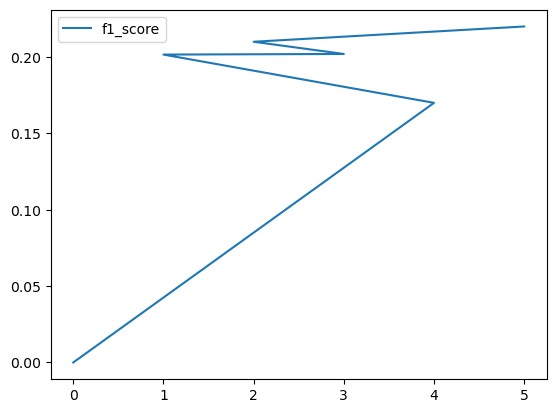

In [192]:
comparison.plot()

In [193]:
## under sampling Smote

In [194]:
scaler = RobustScaler()
X_train_scaled_u = scaler.fit_transform(X_train)
X_test_scaled_u = scaler.transform(X_test)

In [195]:
from imblearn.under_sampling import RandomUnderSampler
under_sampler = RandomUnderSampler(sampling_strategy='auto', random_state=42)
X_resampled_under, y_resampled_under = under_sampler.fit_resample(X_train_scaled_u, y_train)

In [183]:
selector = SelectKBest(f_classif, k=40)
X_train_selected_u = selector.fit_transform(X_resampled_under, y_resampled_under)
X_test_selected_u = selector.transform(X_test_scaled_u)
selected_features_u = X.columns[selector.get_support()]
selected_features_u

Index(['SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
       'CNT_CHILDREN', 'AMT_CREDIT', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_HOUSING_TYPE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION',
       'DAYS_ID_PUBLISH', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_PHONE',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'HOUR_APPR_PROCESS_START', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
       'ORGANIZATION_TYPE', 'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE',
       'WALLSMATERIAL_MODE', 'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_3',
       'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_11',
       'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object')

In [184]:
rf_random_u=RandomForestClassifier(n_estimators=100,random_state=42,class_weight='balanced',max_features='auto',max_depth=10)

In [185]:
rf_random_u.fit(X_train_selected_u,y_resampled_under)

RandomForestClassifier(class_weight='balanced', max_depth=10,
                       max_features='auto', random_state=42)

In [186]:
y_pred_clf_u = rf_random_u.predict(X_test_selected_u)

In [187]:
accuracy_u=accuracy_score(y_test,y_pred_clf_u)
accuracy_u

0.6173520678932972

In [188]:
classification_under_sampling=classification_report(y_test,y_pred_clf_u)
print(classification_under_sampling)

              precision    recall  f1-score   support

           0       0.94      0.62      0.75     38916
           1       0.14      0.61      0.22      3857

    accuracy                           0.62     42773
   macro avg       0.54      0.61      0.48     42773
weighted avg       0.87      0.62      0.70     42773



In [189]:
F1_SCORE=f1_score(y_test,y_pred_clf_u)
F1_SCORE

0.22309773579531966

- I TRIED UNDER SAMPLING WITH ROBUST SCALER but f1 score dont develop 

- low percision in class 1 means that i predict people who dont pay loans false 

## Business KPIs in Bank Loans

In the context of bank loans, several business Key Performance Indicators (KPIs) can significantly impact the business. Here are some key KPIs and their potential impact:

1. **Loan Approval Rate**
   - **Description:** The percentage of loan applications approved out of the total applications received.
   - **Impact:** A higher approval rate may indicate a more lenient credit policy, potentially increasing market share and customer satisfaction. However, it may also lead to higher default rates if credit risk is not managed properly.

2. **Default Rate**
   - **Description:** The percentage of loans that are not repaid as agreed.
   - **Impact:** High default rates can lead to significant financial losses and may necessitate higher provisioning for bad debts. This impacts profitability and can affect the bank's reputation and investor confidence.

3. **Net Interest Margin (NIM)**
   - **Description:** The difference between the interest income generated and the amount of interest paid out, relative to the amount of interest-earning assets.
   - **Impact:** Higher NIM indicates better profitability from lending activities. A declining NIM could signal increased competition or rising funding costs, impacting overall profitability.

4. **Loan-to-Deposit Ratio (LDR)**
   - **Description:** The ratio of a bank's total loans to its total deposits.
   - **Impact:** An optimal LDR indicates effective utilization of deposits to generate income. An excessively high LDR can indicate potential liquidity risks, while a very low LDR may suggest underutilized funds.

5. **Non-Performing Loans (NPL) Ratio**
   - **Description:** The ratio of non-performing loans to total loans.
   - **Impact:** A high NPL ratio can indicate poor credit quality and increase the need for provisions, reducing profitability. It also reflects the bank's ability to manage credit risk.

6. **Customer Acquisition Cost (CAC)**
   - **Description:** The cost associated with acquiring a new customer.
   - **Impact:** High CAC can erode profit margins, especially if the lifetime value of a customer does not offset the acquisition cost. Efficient marketing and sales strategies can help reduce CAC.

7. **Customer Retention Rate**
   - **Description:** The percentage of customers who continue to use the bank's services over a given period.
   - **Impact:** Higher retention rates suggest customer satisfaction and loyalty, leading to more stable revenue streams. It also reduces the need for high spending on customer acquisition.

8. **Loan Growth Rate**
   - **Description:** The rate at which the loan portfolio is expanding over time.
   - **Impact:** Positive loan growth indicates increased demand and successful lending practices. However, rapid growth without proper risk management can lead to higher default rates.

9. **Return on Assets (ROA)**
   - **Description:** The percentage of profit a company earns in relation to its overall assets.
   - **Impact:** Higher ROA indicates efficient management of assets to generate profits. It reflects the bank’s effectiveness in using its assets to create earnings.

10. **Return on Equity (ROE)**
    - **Description:** The percentage of profit generated relative to shareholders' equity.
    - **Impact:** Higher ROE indicates better profitability and efficient use of shareholders’ funds. It is a key measure of financial performance and investor attractiveness.

11. **Cost-to-Income Ratio**
    - **Description:** The ratio of operating costs to operating income.
    - **Impact:** A lower ratio indicates higher efficiency and profitability. High operating costs can erode income, making cost management crucial.

12. **Provision Coverage Ratio**
    - **Description:** The ratio of loan loss provisions to non-performing loans.
    - **Impact:** A higher ratio suggests that the bank has adequately provisioned for potential loan losses, enhancing financial stability and investor confidence.

13. **Average Loan Size**
    - **Description:** The average size of loans issued.
    - **Impact:** Helps in understanding the bank's focus – whether it's on small personal loans or large commercial loans. Different loan sizes have different risk profiles and operational requirements.

14. **Customer Satisfaction Score**
    - **Description:** A measure of customer satisfaction with the bank's services.
    - **Impact:** High satisfaction scores can lead to better retention rates, positive word-of-mouth, and increased cross-selling opportunities.

15. **Digital Engagement Rate**
    - **Description:** The percentage of customers using digital banking services.
    - **Impact:** High digital engagement can reduce operational costs and improve customer convenience and satisfaction. It also indicates the bank's success in digital transformation efforts.

### Conclusion
Effective management and monitoring of these KPIs are crucial for a bank’s success. They provide insights into various aspects of the business, from customer acquisition and retention to financial health and operational efficiency. Balancing growth with risk management is key to maintaining a healthy loan portfolio and ensuring long-term profitability and stability.